In [1]:
from typing import Dict, Iterable, Optional

import numpy as np
import torch
import scanpy as sc

from torch.distributions import Normal, Poisson
from torch.distributions import kl_divergence as kld
from torch import tensor
from complementary_models import HALOMASKVIR as HALOVI
from complementary_models import HALOMASKVAE as HALOVAE
import scvi
import pandas as pd

import matplotlib.pyplot as plt
import seaborn as sns
import scipy


Global seed set to 0


## Data Preprocess

In [2]:
adata_multi = sc.read_10x_mtx('./data/datasets/NEAT_Seq/outputs/RNA_ATAC/',gex_only=False)
metadata = pd.read_csv('./data/datasets/NEAT_Seq/outputs/metadata.csv',index_col = 0)
adata_multi.obs = pd.merge(adata_multi.obs, metadata, left_index=True, right_index=True)

In [3]:
adata_multi

AnnData object with n_obs × n_vars = 3841 × 117554
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'cell_id', 'Sample', 'TSSEnrichment', 'ReadsInTSS', 'ReadsInPromoter', 'ReadsInBlacklist', 'PromoterRatio', 'PassQC', 'NucleosomeRatio', 'nMultiFrags', 'nMonoFrags', 'nFrags', 'nDiFrags', 'BlacklistRatio', 'Clusters', 'ReadsInPeaks', 'FRIP', 'cell_id2', 'nCount_ATAC', 'nFeature_ATAC', 'nCount_ChromVar', 'nFeature_ChromVar', 'RNA_snn_res.0.6', 'seurat_clusters', 'nCount_ADT', 'nFeature_ADT', 'S.Score', 'G2M.Score', 'Phase', 'FOXP3-norm', 'Helios-norm', 'Tbet-norm', 'GATA3-norm', 'RORgT-norm'
    var: 'gene_ids', 'feature_types'

In [4]:
adata_multi = adata_multi[adata_multi.obs.ReadsInPeaks > 4000, :]

In [5]:
sc.pp.filter_genes(adata_multi, min_cells=10)

/home/haiyi/anaconda3/envs/halo/lib/python3.9/site-packages/scanpy/preprocessing/_simple.py:251: ImplicitModificationWarning: Trying to modify attribute `.var` of view, initializing view as actual.
  adata.var['n_cells'] = number


In [6]:
adata_multi.obs["batch_id"] = 1
adata_multi.var["modality"] =adata_multi.var["feature_types"]
adata_multi.var["modality"].value_counts()
adata_mvi = scvi.data.organize_multiome_anndatas(adata_multi)
adata_mvi 

AnnData object with n_obs × n_vars = 3370 × 91583
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'cell_id', 'Sample', 'TSSEnrichment', 'ReadsInTSS', 'ReadsInPromoter', 'ReadsInBlacklist', 'PromoterRatio', 'PassQC', 'NucleosomeRatio', 'nMultiFrags', 'nMonoFrags', 'nFrags', 'nDiFrags', 'BlacklistRatio', 'Clusters', 'ReadsInPeaks', 'FRIP', 'cell_id2', 'nCount_ATAC', 'nFeature_ATAC', 'nCount_ChromVar', 'nFeature_ChromVar', 'RNA_snn_res.0.6', 'seurat_clusters', 'nCount_ADT', 'nFeature_ADT', 'S.Score', 'G2M.Score', 'Phase', 'FOXP3-norm', 'Helios-norm', 'Tbet-norm', 'GATA3-norm', 'RORgT-norm', 'batch_id', 'modality'
    var: 'gene_ids', 'feature_types', 'n_cells', 'modality'

In [7]:
adata_mvi.obs['Clusters'] = adata_mvi.obs['Clusters'].astype(str).astype('category')
old_to_new = dict(
    C1='Act.',
    C2='Treg',
    C3='Th17',
    C4='Tcm',
    C5='Th2',
    C6='Th1',
    C7='Uncom.'
)
adata_mvi.obs['new_clusters'] = (
    adata_mvi.obs['Clusters']
    .map(old_to_new)
    .astype('category')
)

Cluster_color = {
                "Act.": "#D51F26",
                "Treg": "#272E6A",
                "Th17": "#208A42",
                "Tcm": "#89288F",
                "Th2": "#F47D2B",
                "Th1": "#FEE500",
                "Uncom.": "#8A9FD1"    
                }

# adata_mvi.obs['GATA3-norm'] = (adata_mvi.obs['GATA3-norm'] - adata_mvi.obs['GATA3-norm'].min()) / (adata_mvi.obs['GATA3-norm'].max() - adata_mvi.obs['GATA3-norm'].min())
adata_mvi.obs['new_clusters'].value_counts()

Tcm       1004
Th17       758
Th1        611
Uncom.     390
Th2        372
Treg       190
Act.        45
Name: new_clusters, dtype: int64

In [8]:
adata_mvi.write_h5ad("./data/datasets/NEAT_Seq/outputs/multiome_interim.h5ad")

## HALO Training

In [8]:
HALOVI.setup_anndata(adata_mvi, batch_key="modality", time_key='GATA3-norm')
model = HALOVI(
    adata_mvi,
    n_genes=(adata_mvi.var['feature_types']=='Gene Expression').sum(),
    n_regions=(adata_mvi.var['feature_types']=='Peaks').sum(),
    n_layers = 2,
    n_latent = 30,
    n_dependent=15
)

n_genes :13380
n_peaks:78203
fine tune is False
gate decoder initialization n_input 30, n_output 78203,         n_hidden_local 20, n_hidden_global 128, n_cat_list [1], *cat_list 1


In [24]:
## train both RNA and ATAC
import warnings
warnings.filterwarnings("ignore")
model.module.set_finetune_params(0)
model.module.set_train_params(expr_train=True, acc_train=True)
model.train(max_epochs=1000, batch_size=256)

GPU available: True, used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Epoch 1000/1000: 100%|██████████| 1000/1000 [39:50<00:00,  2.39s/it, loss=5.7e+04, v_num=1] 


In [25]:
model.save("model_NEAT_seq_filtered_30LF_nocausal_epoch1000",overwrite=True)

In [26]:
latent_expr, latent_acc,latent_expr_dep, latent_atac_dep, latent_expr_indep, latent_atac_indep, times  = model.get_latent_representation()

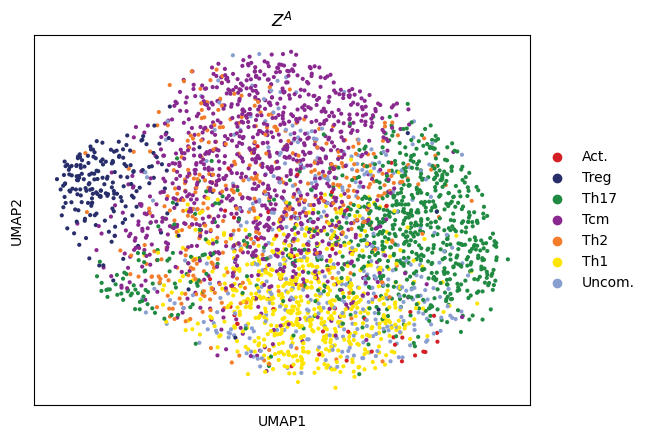

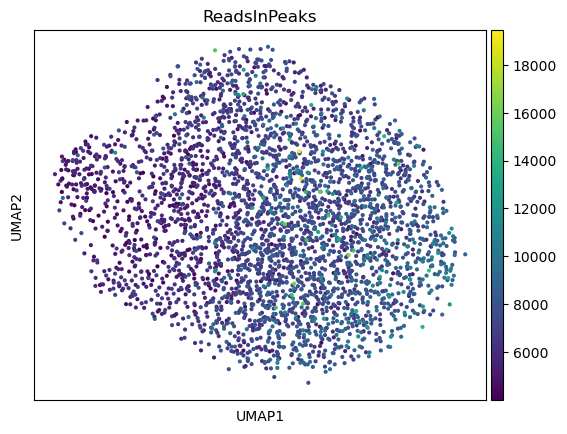

In [27]:
adata_mvi.obsm["latent"] = latent_acc
sc.pp.neighbors(adata_mvi, use_rep="latent", n_neighbors=25)

sc.tl.umap(adata_mvi,min_dist =0.5)
# sc.tl.louvain(adata_mvi)

# %matplotlib inline
# sc.pl.umap(adatssa_mvi,color='GATA3-norm',title = '$Z^{A}$',
#        vmin = 'p2', vmax= 'p98')
# plt.show()

%matplotlib inline
sc.pl.umap(adata_mvi,color='new_clusters',title = '$Z^{A}$',
                palette=Cluster_color
             )
plt.show()

%matplotlib inline
sc.pl.umap(adata_mvi,color=['ReadsInPeaks'])
plt.show()


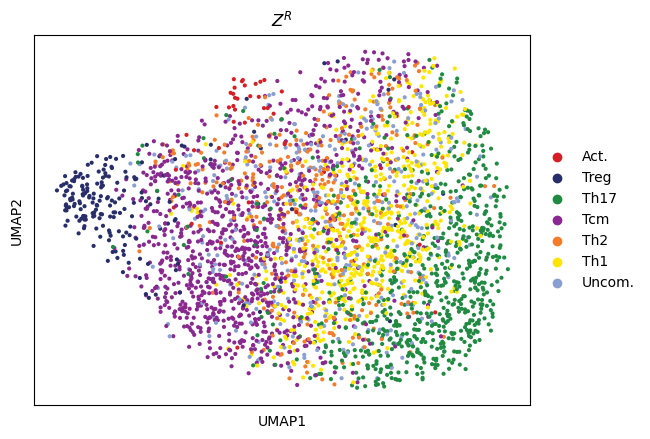

In [28]:
adata_mvi.obsm["latent"] = latent_expr
sc.pp.neighbors(adata_mvi, use_rep="latent", n_neighbors=25)

sc.tl.umap(adata_mvi,min_dist =0.5)

# %matplotlib inline
# sc.pl.umap(adata_mvi,color='GATA3-norm',title = '$Z^{R}$',
#        vmin = 'p2', vmax= 'p98')
# plt.show()

%matplotlib inline
sc.pl.umap(adata_mvi,color='new_clusters',title = '$Z^{R}$',
                palette=Cluster_color
             )
plt.show()

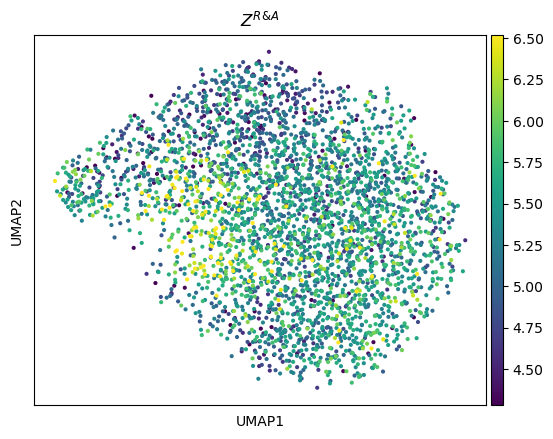

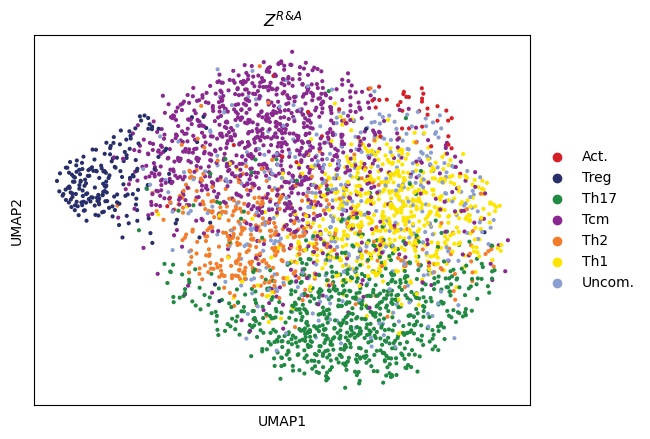

In [29]:
adata_mvi.obsm["latent"] = np.concatenate((latent_expr, latent_acc), axis=1)
sc.pp.neighbors(adata_mvi, use_rep="latent", n_neighbors=25)

sc.tl.umap(adata_mvi,min_dist =0.5)

%matplotlib inline
sc.pl.umap(adata_mvi,color='GATA3-norm',title = '$Z^{R & A}$',
       vmin = 'p2', vmax= 'p98')
plt.show()

%matplotlib inline
sc.pl.umap(adata_mvi,color='new_clusters',title = '$Z^{R & A}$',
                palette=Cluster_color
             )
plt.show()

In [30]:
model.train(max_epochs=500, batch_size=256)

GPU available: True, used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Epoch 500/500: 100%|██████████| 500/500 [19:41<00:00,  2.36s/it, loss=5.69e+04, v_num=1]


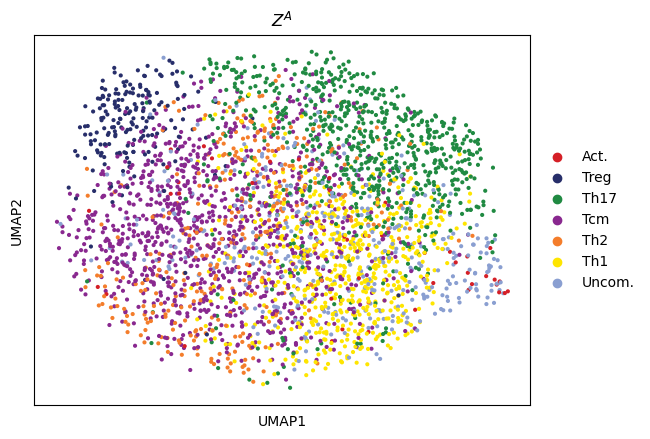

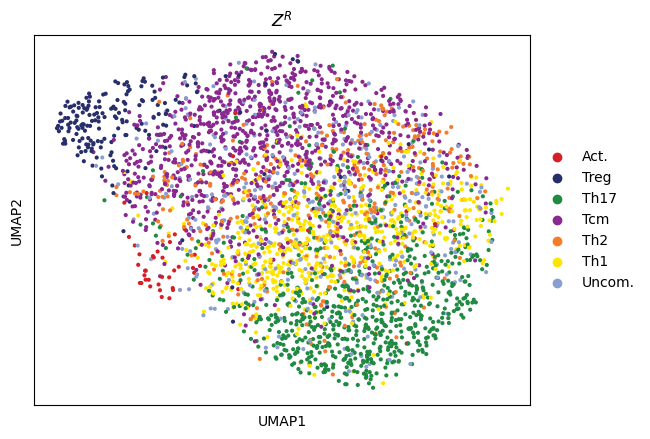

In [31]:
latent_expr, latent_acc,latent_expr_dep, latent_atac_dep, latent_expr_indep, latent_atac_indep, times  = model.get_latent_representation()

adata_mvi.obsm["latent"] = latent_acc
sc.pp.neighbors(adata_mvi, use_rep="latent", n_neighbors=25)

sc.tl.umap(adata_mvi,min_dist =0.5)

%matplotlib inline
sc.pl.umap(adata_mvi,color='new_clusters',title = '$Z^{A}$',
                palette=Cluster_color
             )
plt.show()


adata_mvi.obsm["latent"] = latent_expr
sc.pp.neighbors(adata_mvi, use_rep="latent", n_neighbors=25)

sc.tl.umap(adata_mvi,min_dist =0.5)

%matplotlib inline
sc.pl.umap(adata_mvi,color='new_clusters',title = '$Z^{R}$',
                palette=Cluster_color
             )
plt.show()

In [32]:
model.save("model_NEAT_seq_filtered_30LF_nocausal_epoch1500",overwrite=True)

In [33]:
model.train(max_epochs=500, batch_size=256)

GPU available: True, used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Epoch 500/500: 100%|██████████| 500/500 [19:44<00:00,  2.37s/it, loss=5.68e+04, v_num=1]


In [34]:
model.save("model_NEAT_seq_filtered_30LF_nocausal_epoch2000",overwrite=True)

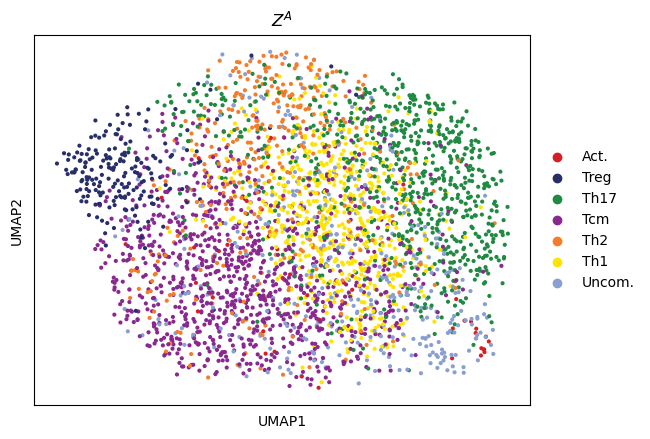

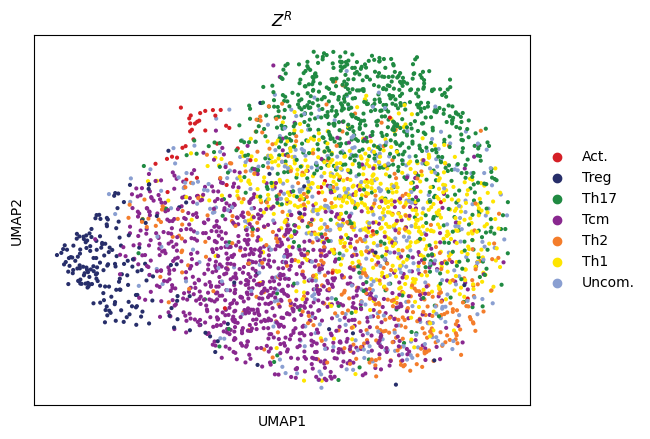

In [35]:
latent_expr, latent_acc,latent_expr_dep, latent_atac_dep, latent_expr_indep, latent_atac_indep, times  = model.get_latent_representation()

adata_mvi.obsm["latent"] = latent_acc
sc.pp.neighbors(adata_mvi, use_rep="latent", n_neighbors=25)

sc.tl.umap(adata_mvi,min_dist =0.5)

%matplotlib inline
sc.pl.umap(adata_mvi,color='new_clusters',title = '$Z^{A}$',
                palette=Cluster_color
             )
plt.show()


adata_mvi.obsm["latent"] = latent_expr
sc.pp.neighbors(adata_mvi, use_rep="latent", n_neighbors=25)

sc.tl.umap(adata_mvi,min_dist =0.5)

%matplotlib inline
sc.pl.umap(adata_mvi,color='new_clusters',title = '$Z^{R}$',
                palette=Cluster_color
             )
plt.show()

## Causal Constrain

In [ ]:
model = model.load("model_NEAT_seq_filtered_20LF_nocausal_epoch2000",adata_mvi)

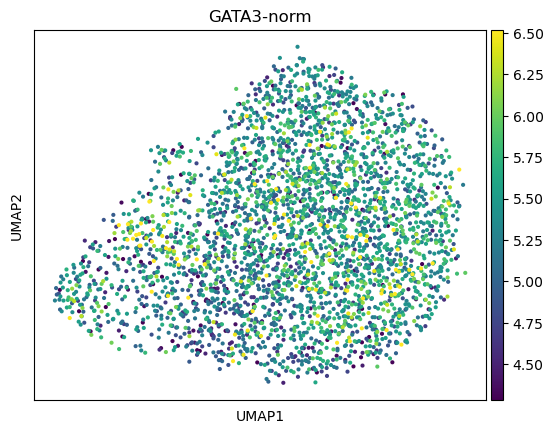

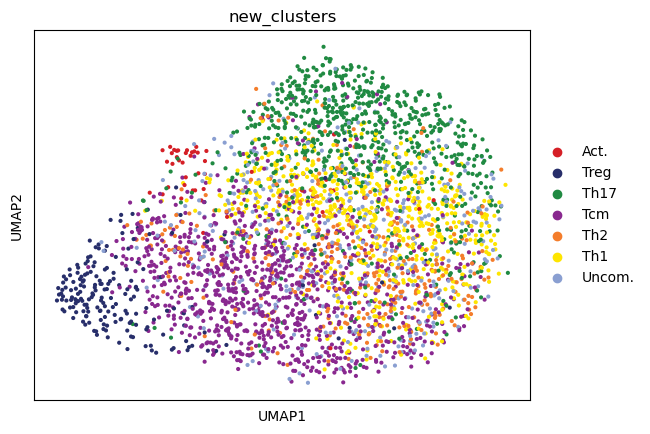

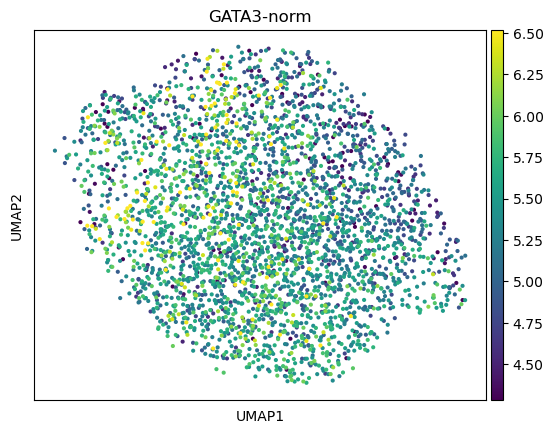

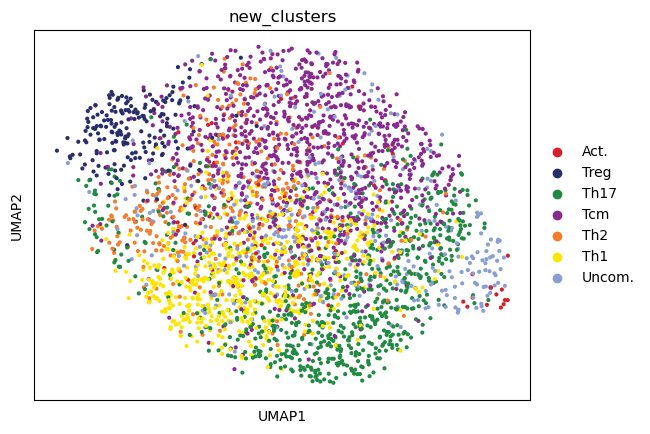

In [36]:
latent_expr, latent_acc,latent_atac_dep, latent_expr_dep, latent_atac_indep, latent_expr_indep, times  = model.get_latent_representation()

adata_mvi.obsm["latent"] = latent_expr
sc.pp.neighbors(adata_mvi, use_rep="latent", n_neighbors=25)

sc.tl.umap(adata_mvi,min_dist =0.5)

%matplotlib inline
sc.pl.umap(adata_mvi,color='GATA3-norm', vmin = 'p2', vmax= 'p98')
plt.show()

%matplotlib inline
sc.pl.umap(adata_mvi,color='new_clusters',palette=Cluster_color)
plt.show()

adata_mvi.obsm["latent"] = latent_acc
sc.pp.neighbors(adata_mvi, use_rep="latent", n_neighbors=25)

sc.tl.umap(adata_mvi,min_dist =0.5)

%matplotlib inline
sc.pl.umap(adata_mvi,color='GATA3-norm', vmin = 'p2', vmax= 'p98')
plt.show()

%matplotlib inline
sc.pl.umap(adata_mvi,color='new_clusters',palette=Cluster_color)
plt.show()

In [37]:
model.module.alpha = 0.05
model.module.beta_2 = 1e7
model.module.beta_3 = 2e8
model.module.beta_1 = 1e7
print(model.module.alpha)

0.05


In [38]:
## finetune without L0
model.module.set_finetune_params(2)
model.module.set_train_params(expr_train=True, acc_train=True)
model.plan_kwargs = {"n_epochs_kl_warmup":300}
model.train(max_epochs=500, batch_size=512)

GPU available: True, used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Epoch 1/500:   0%|          | 0/500 [00:00<?, ?it/s]reconst_loss 5.71E+04, nod_loss 7.17E+04
reconst_loss 5.71E+04, nod_loss 7.62E+04
reconst_loss 5.68E+04, nod_loss 7.61E+04
reconst_loss 5.68E+04, nod_loss 6.45E+04
reconst_loss 5.60E+04, nod_loss 7.14E+04
reconst_loss 5.70E+04, nod_loss 1.06E+05
Epoch 2/500:   0%|          | 1/500 [00:02<24:03,  2.89s/it, loss=1.35e+05, v_num=1]reconst_loss 5.70E+04, nod_loss 7.17E+04
reconst_loss 5.69E+04, nod_loss 1.06E+05
reconst_loss 5.61E+04, nod_loss 4.89E+04
reconst_loss 5.73E+04, nod_loss 6.54E+04
reconst_loss 5.65E+04, nod_loss 7.15E+04
reconst_loss 5.69E+04, nod_loss 7.84E+04
Epoch 3/500:   0%|          | 2/500 [00:05<22:33,  2.72s/it, loss=1.32e+05, v_num=1]reconst_loss 5.70E+04, nod_loss 7.97E+04
reconst_loss 5.68E+04, nod_loss 6.21E+04
reconst_loss 5.68E+04, nod_loss 6.49E+04
reconst_loss 5.65E+04, nod_loss 8.00E+04
reconst_loss 5.69E+04, nod_loss 8.51E+04
reconst_loss 5.67E+04, nod_loss 6.25E+04
Epoch 4/500:   1%|          | 3/500 [00:08

In [39]:
model.save("model_NEAT_seq_filtered_30LF_causal_alpha_0.05_epoch_500",overwrite=True)

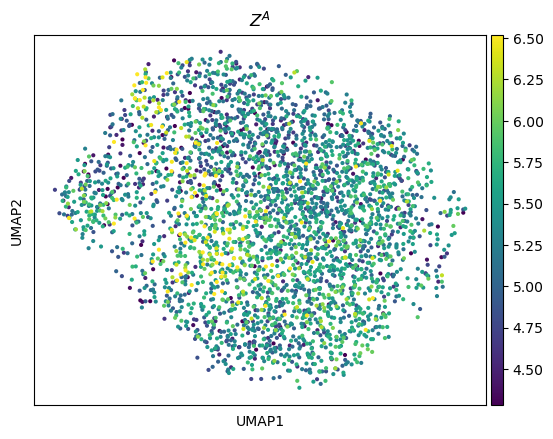

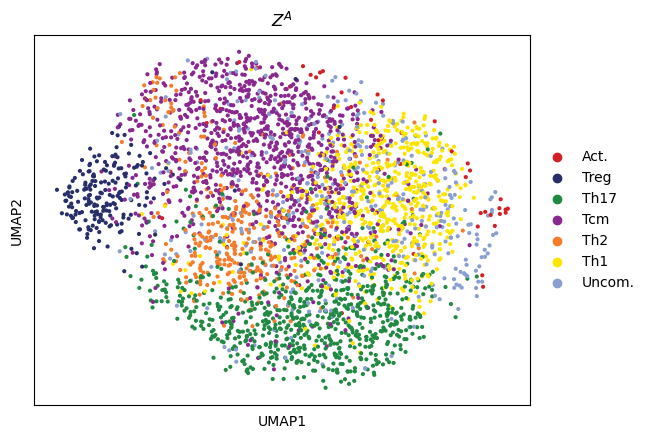

In [40]:
latent_expr, latent_acc,latent_atac_dep, latent_expr_dep, latent_atac_indep, latent_expr_indep, times  = model.get_latent_representation()

adata_mvi.obsm["latent"] = latent_acc
sc.pp.neighbors(adata_mvi, use_rep="latent", n_neighbors=25)

sc.tl.umap(adata_mvi,min_dist =0.5)
# sc.tl.louvain(adata_mvi)

%matplotlib inline
sc.pl.umap(adata_mvi,color='GATA3-norm',title = '$Z^{A}$',
       vmin = 'p2', vmax= 'p98')
plt.show()

%matplotlib inline
sc.pl.umap(adata_mvi,color='new_clusters',title = '$Z^{A}$',
                palette=Cluster_color
             )
plt.show()

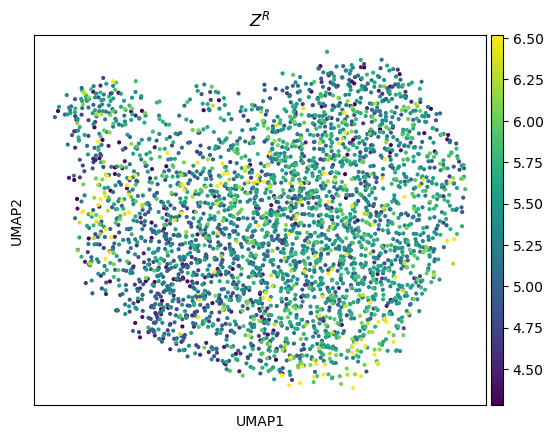

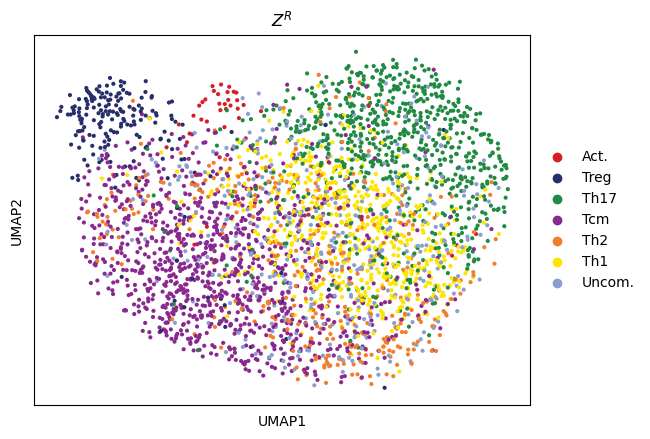

In [41]:
adata_mvi.obsm["latent"] = latent_expr
sc.pp.neighbors(adata_mvi, use_rep="latent", n_neighbors=25)

sc.tl.umap(adata_mvi,min_dist =0.5)

%matplotlib inline
sc.pl.umap(adata_mvi,color='GATA3-norm',title = '$Z^{R}$',
       vmin = 'p2', vmax= 'p98')
plt.show()

%matplotlib inline
sc.pl.umap(adata_mvi,color='new_clusters',title = '$Z^{R}$',
                palette=Cluster_color
             )
plt.show()

In [42]:
model.train(max_epochs=500, batch_size=512)

GPU available: True, used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Epoch 1/500:   0%|          | 0/500 [00:00<?, ?it/s]reconst_loss 5.66E+04, nod_loss 6.20E+04
reconst_loss 5.65E+04, nod_loss 7.06E+04
reconst_loss 5.72E+04, nod_loss 8.68E+04
reconst_loss 5.72E+04, nod_loss 5.98E+04
reconst_loss 5.66E+04, nod_loss 9.14E+04
reconst_loss 5.70E+04, nod_loss 7.52E+04
Epoch 2/500:   0%|          | 1/500 [00:02<21:48,  2.62s/it, loss=1.31e+05, v_num=1]reconst_loss 5.69E+04, nod_loss 8.11E+04
reconst_loss 5.76E+04, nod_loss 7.01E+04
reconst_loss 5.64E+04, nod_loss 7.37E+04
reconst_loss 5.70E+04, nod_loss 5.74E+04
reconst_loss 5.67E+04, nod_loss 7.37E+04
reconst_loss 5.62E+04, nod_loss 8.42E+04
Epoch 3/500:   0%|          | 2/500 [00:05<21:47,  2.63s/it, loss=1.31e+05, v_num=1]reconst_loss 5.64E+04, nod_loss 5.74E+04
reconst_loss 5.66E+04, nod_loss 5.60E+04
reconst_loss 5.73E+04, nod_loss 9.11E+04
reconst_loss 5.68E+04, nod_loss 9.62E+04
reconst_loss 5.70E+04, nod_loss 7.30E+04
reconst_loss 5.69E+04, nod_loss 7.54E+04
Epoch 4/500:   1%|          | 3/500 [00:07

In [43]:
model.save("model_NEAT_seq_30LF_filtered_causal_alpha_0.05_epoch_1000",overwrite=True)

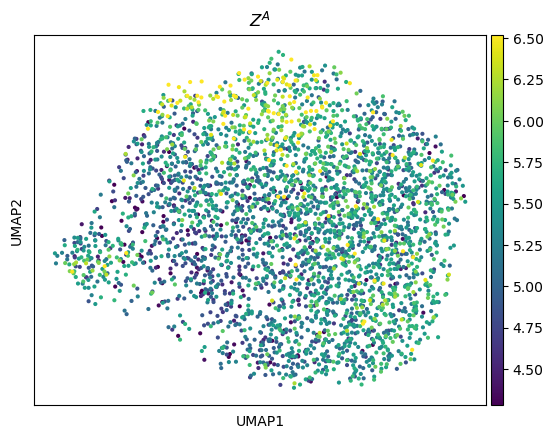

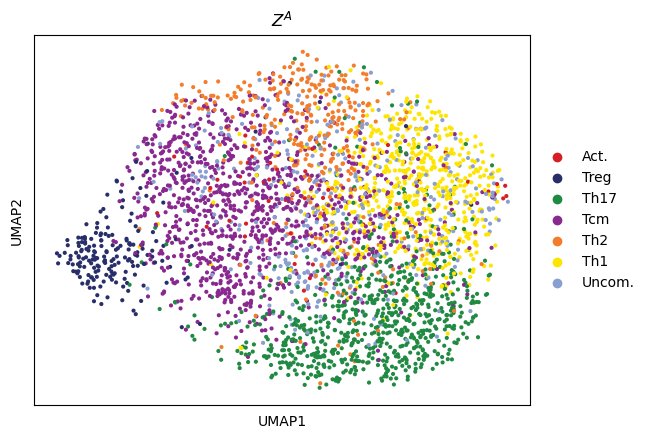

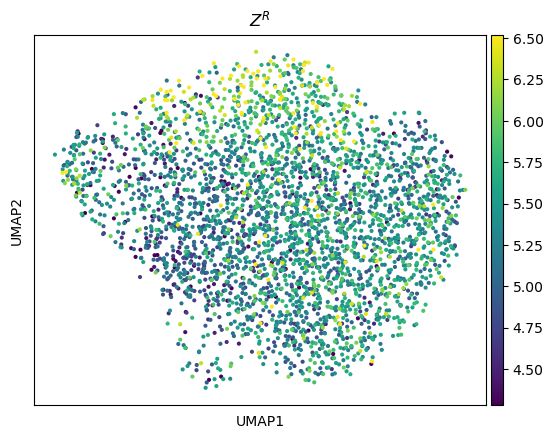

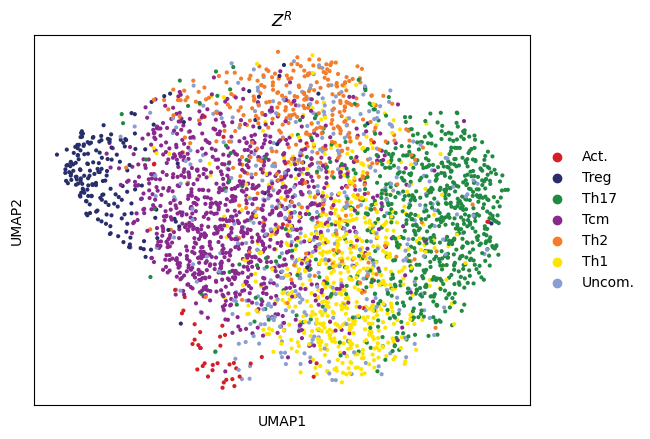

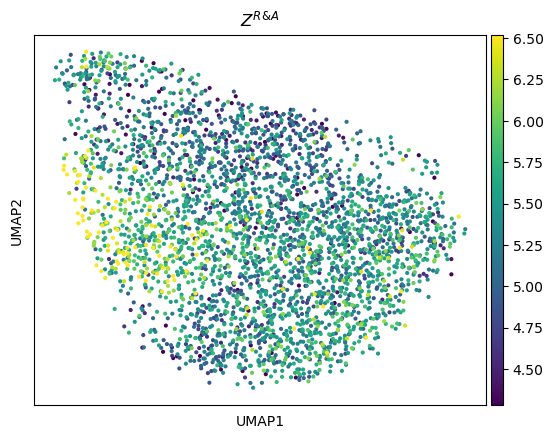

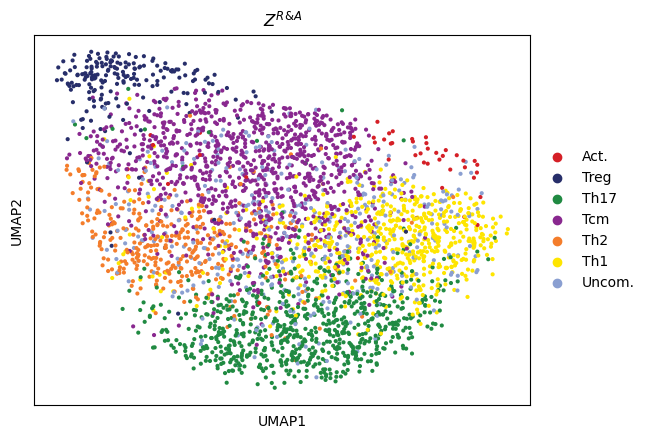

In [44]:
latent_expr, latent_acc,latent_atac_dep, latent_expr_dep, latent_atac_indep, latent_expr_indep, times  = model.get_latent_representation()

adata_mvi.obsm["latent"] = latent_acc
sc.pp.neighbors(adata_mvi, use_rep="latent", n_neighbors=25)

sc.tl.umap(adata_mvi,min_dist =0.5)
# sc.tl.louvain(adata_mvi)

%matplotlib inline
sc.pl.umap(adata_mvi,color='GATA3-norm',title = '$Z^{A}$',
       vmin = 'p2', vmax= 'p98')
plt.show()

%matplotlib inline
sc.pl.umap(adata_mvi,color='new_clusters',title = '$Z^{A}$',
                palette=Cluster_color
             )
plt.show()


adata_mvi.obsm["latent"] = latent_expr
sc.pp.neighbors(adata_mvi, use_rep="latent", n_neighbors=25)

sc.tl.umap(adata_mvi,min_dist =0.5)

%matplotlib inline
sc.pl.umap(adata_mvi,color='GATA3-norm',title = '$Z^{R}$',
       vmin = 'p2', vmax= 'p98')
plt.show()

%matplotlib inline
sc.pl.umap(adata_mvi,color='new_clusters',title = '$Z^{R}$',
                palette=Cluster_color
             )
plt.show()

adata_mvi.obsm["latent"] = np.concatenate((latent_expr, latent_acc), axis=1)
sc.pp.neighbors(adata_mvi, use_rep="latent", n_neighbors=25)

sc.tl.umap(adata_mvi,min_dist =0.5)

%matplotlib inline
sc.pl.umap(adata_mvi,color='GATA3-norm',title = '$Z^{R & A}$',
       vmin = 'p2', vmax= 'p98')
plt.show()

%matplotlib inline
sc.pl.umap(adata_mvi,color='new_clusters',title = '$Z^{R & A}$',
                palette=Cluster_color
             )
plt.show()

In [45]:
model.train(max_epochs=500, batch_size=256)

GPU available: True, used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Epoch 1/500:   0%|          | 0/500 [00:00<?, ?it/s]reconst_loss 5.61E+04, nod_loss 1.21E+05
reconst_loss 5.75E+04, nod_loss 1.08E+05
reconst_loss 5.71E+04, nod_loss 1.01E+05
reconst_loss 5.69E+04, nod_loss 4.61E+04
reconst_loss 5.74E+04, nod_loss 1.03E+05
reconst_loss 5.74E+04, nod_loss 8.86E+04
reconst_loss 5.60E+04, nod_loss 1.68E+05
reconst_loss 5.68E+04, nod_loss 1.32E+05
reconst_loss 5.64E+04, nod_loss 1.47E+05
reconst_loss 5.65E+04, nod_loss 1.29E+05
reconst_loss 5.69E+04, nod_loss 1.53E+05
reconst_loss 5.70E+04, nod_loss 1.43E+05
Epoch 2/500:   0%|          | 1/500 [00:03<27:54,  3.35s/it, loss=1.77e+05, v_num=1]reconst_loss 5.73E+04, nod_loss 1.51E+05
reconst_loss 5.69E+04, nod_loss 8.57E+04
reconst_loss 5.70E+04, nod_loss 1.15E+05
reconst_loss 5.69E+04, nod_loss 1.33E+05
reconst_loss 5.62E+04, nod_loss 1.58E+05
reconst_loss 5.69E+04, nod_loss 9.79E+04
reconst_loss 5.68E+04, nod_loss 1.04E+05
reconst_loss 5.64E+04, nod_loss 1.50E+05
reconst_loss 5.65E+04, nod_loss 1.18E+05
rec

In [46]:
model.save("model_NEAT_seq_30LF_filtered_causal_alpha_0.05_epoch_1500",overwrite=True)

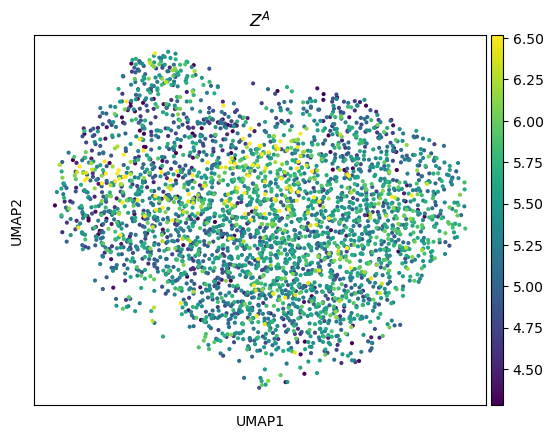

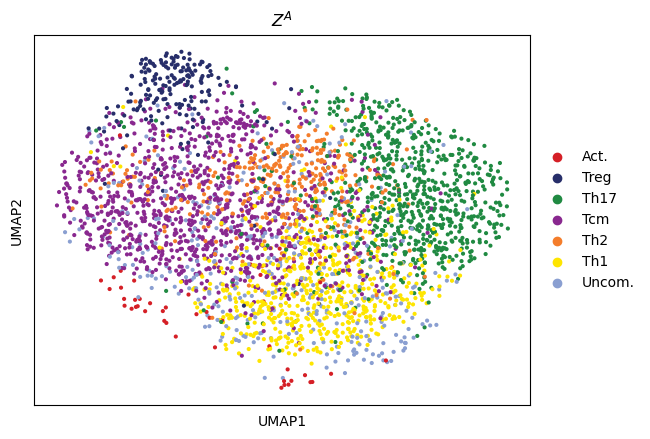

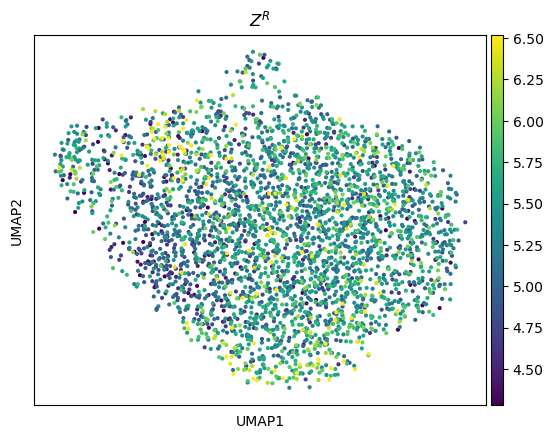

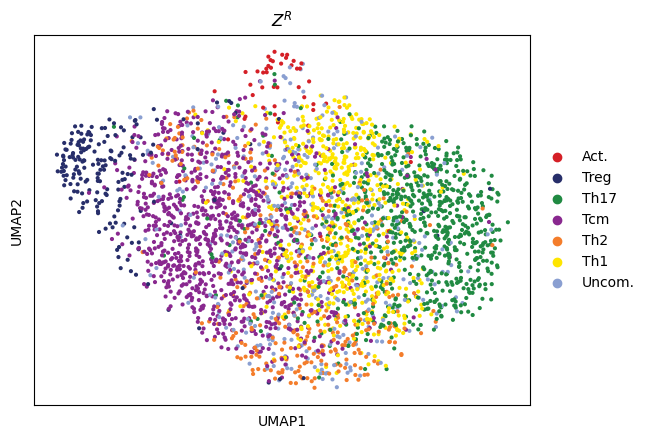

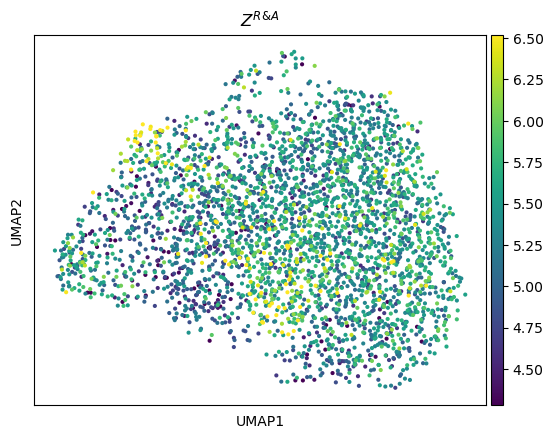

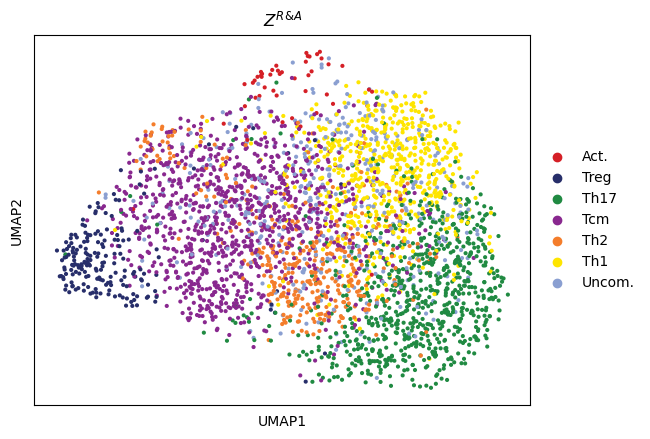

In [47]:
latent_expr, latent_acc,latent_atac_dep, latent_expr_dep, latent_atac_indep, latent_expr_indep, times  = model.get_latent_representation()

adata_mvi.obsm["latent"] = latent_acc
sc.pp.neighbors(adata_mvi, use_rep="latent", n_neighbors=25)

sc.tl.umap(adata_mvi,min_dist =0.5)
# sc.tl.louvain(adata_mvi)

%matplotlib inline
sc.pl.umap(adata_mvi,color='GATA3-norm',title = '$Z^{A}$',
       vmin = 'p2', vmax= 'p98')
plt.show()

%matplotlib inline
sc.pl.umap(adata_mvi,color='new_clusters',title = '$Z^{A}$',
                palette=Cluster_color
             )
plt.show()


adata_mvi.obsm["latent"] = latent_expr
sc.pp.neighbors(adata_mvi, use_rep="latent", n_neighbors=25)

sc.tl.umap(adata_mvi,min_dist =0.5)

%matplotlib inline
sc.pl.umap(adata_mvi,color='GATA3-norm',title = '$Z^{R}$',
       vmin = 'p2', vmax= 'p98')
plt.show()

%matplotlib inline
sc.pl.umap(adata_mvi,color='new_clusters',title = '$Z^{R}$',
                palette=Cluster_color
             )
plt.show()

adata_mvi.obsm["latent"] = np.concatenate((latent_expr, latent_acc), axis=1)
sc.pp.neighbors(adata_mvi, use_rep="latent", n_neighbors=25)

sc.tl.umap(adata_mvi,min_dist =0.5)

%matplotlib inline
sc.pl.umap(adata_mvi,color='GATA3-norm',title = '$Z^{R & A}$',
       vmin = 'p2', vmax= 'p98')
plt.show()

%matplotlib inline
sc.pl.umap(adata_mvi,color='new_clusters',title = '$Z^{R & A}$',
                palette=Cluster_color
             )
plt.show()

In [48]:
model.train(max_epochs=500, batch_size=256)

GPU available: True, used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Epoch 1/500:   0%|          | 0/500 [00:00<?, ?it/s]reconst_loss 5.65E+04, nod_loss 1.49E+05
reconst_loss 5.63E+04, nod_loss 8.18E+04
reconst_loss 5.67E+04, nod_loss 1.08E+05
reconst_loss 5.69E+04, nod_loss 1.04E+05
reconst_loss 5.68E+04, nod_loss 1.36E+05
reconst_loss 5.76E+04, nod_loss 1.36E+05
reconst_loss 5.70E+04, nod_loss 1.28E+05
reconst_loss 5.69E+04, nod_loss 1.06E+05
reconst_loss 5.72E+04, nod_loss 1.43E+05
reconst_loss 5.61E+04, nod_loss 9.90E+04
reconst_loss 5.62E+04, nod_loss 1.08E+05
reconst_loss 5.71E+04, nod_loss 1.25E+05
Epoch 2/500:   0%|          | 1/500 [00:03<27:49,  3.35s/it, loss=1.76e+05, v_num=1]reconst_loss 5.72E+04, nod_loss 6.54E+04
reconst_loss 5.65E+04, nod_loss 1.25E+05
reconst_loss 5.76E+04, nod_loss 1.11E+05
reconst_loss 5.69E+04, nod_loss 1.06E+05
reconst_loss 5.70E+04, nod_loss 1.67E+05
reconst_loss 5.65E+04, nod_loss 1.30E+05
reconst_loss 5.63E+04, nod_loss 1.45E+05
reconst_loss 5.66E+04, nod_loss 1.35E+05
reconst_loss 5.61E+04, nod_loss 1.16E+05
rec

In [49]:
model.save("model_NEAT_seq_30LF_filtered_causal_alpha_0.05_epoch_2000",overwrite=True)

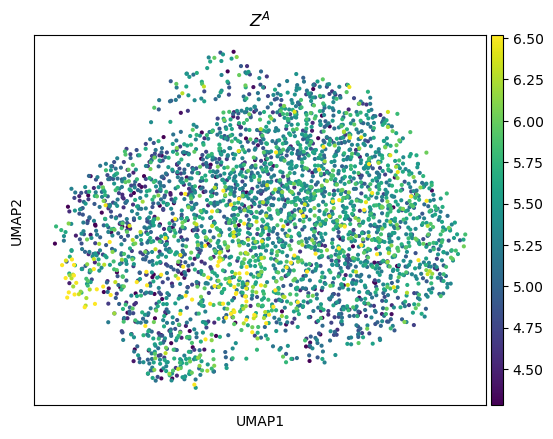

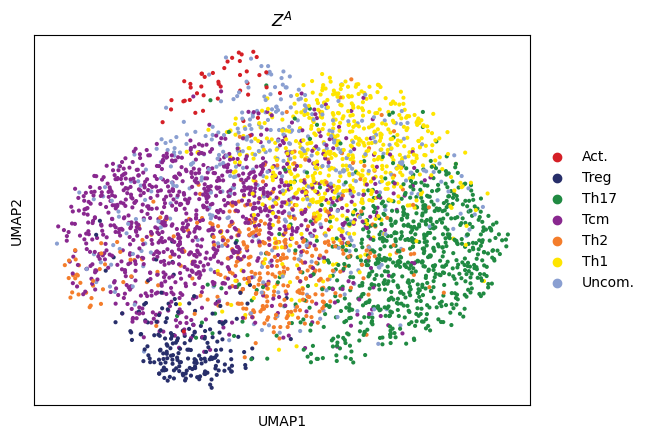

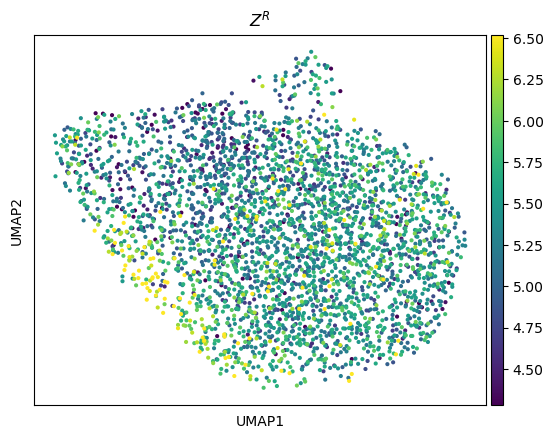

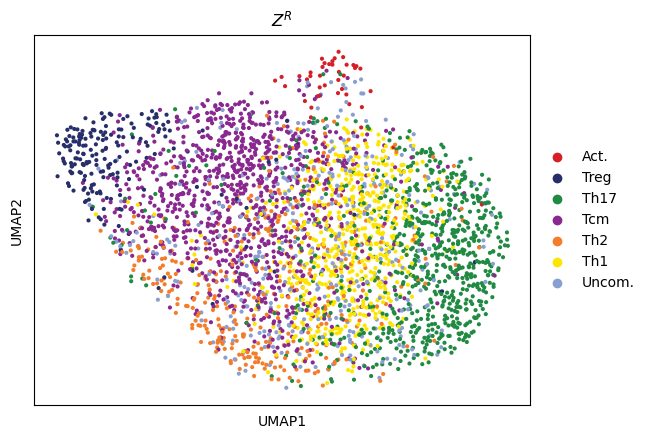

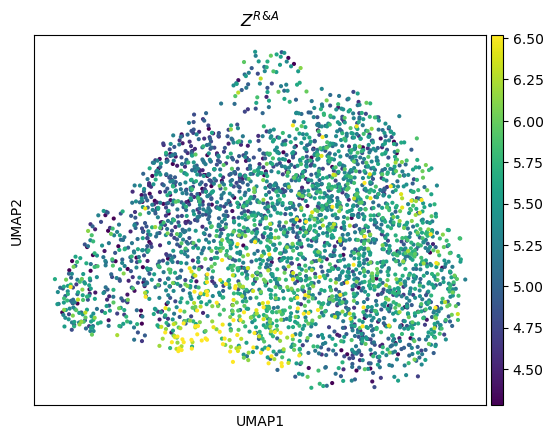

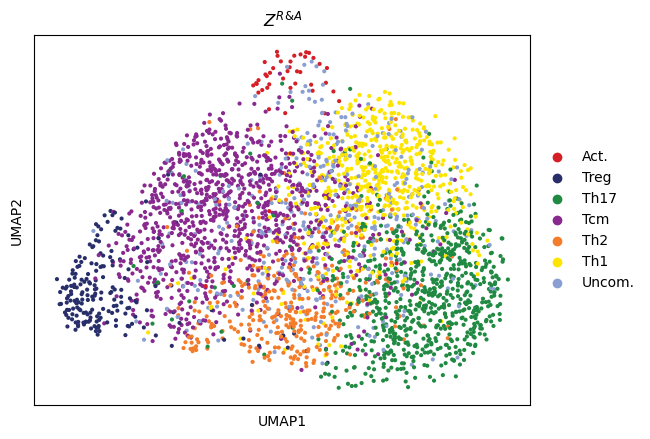

In [50]:
latent_expr, latent_acc,latent_atac_dep, latent_expr_dep, latent_atac_indep, latent_expr_indep, times  = model.get_latent_representation()

adata_mvi.obsm["latent"] = latent_acc
sc.pp.neighbors(adata_mvi, use_rep="latent", n_neighbors=25)

sc.tl.umap(adata_mvi,min_dist =0.5)
# sc.tl.louvain(adata_mvi)

%matplotlib inline
sc.pl.umap(adata_mvi,color='GATA3-norm',title = '$Z^{A}$',
       vmin = 'p2', vmax= 'p98')
plt.show()

%matplotlib inline
sc.pl.umap(adata_mvi,color='new_clusters',title = '$Z^{A}$',
                palette=Cluster_color
             )
plt.show()


adata_mvi.obsm["latent"] = latent_expr
sc.pp.neighbors(adata_mvi, use_rep="latent", n_neighbors=25)

sc.tl.umap(adata_mvi,min_dist =0.5)

%matplotlib inline
sc.pl.umap(adata_mvi,color='GATA3-norm',title = '$Z^{R}$',
       vmin = 'p2', vmax= 'p98')
plt.show()

%matplotlib inline
sc.pl.umap(adata_mvi,color='new_clusters',title = '$Z^{R}$',
                palette=Cluster_color
             )
plt.show()

adata_mvi.obsm["latent"] = np.concatenate((latent_expr, latent_acc), axis=1)
sc.pp.neighbors(adata_mvi, use_rep="latent", n_neighbors=25)

sc.tl.umap(adata_mvi,min_dist =0.5)

%matplotlib inline
sc.pl.umap(adata_mvi,color='GATA3-norm',title = '$Z^{R & A}$',
       vmin = 'p2', vmax= 'p98')
plt.show()

%matplotlib inline
sc.pl.umap(adata_mvi,color='new_clusters',title = '$Z^{R & A}$',
                palette=Cluster_color
             )
plt.show()

## load pretrain model

In [9]:
model = model.load("model_NEAT_seq_30LF_filtered_causal_alpha_0.05_epoch_1000",adata_mvi)

INFO     File model_NEAT_seq_30LF_filtered_causal_alpha_0.05_epoch_1000/model.pt already     
         downloaded                                                                          
n_genes :13380
n_peaks:78203
fine tune is False
gate decoder initialization n_input 30, n_output 78203,         n_hidden_local 20, n_hidden_global 128, n_cat_list [1], *cat_list 1


In [12]:
latent_expr, latent_acc,latent_atac_dep, latent_expr_dep, latent_atac_indep, latent_expr_indep, times  = model.get_latent_representation()

In [11]:
sc.settings.vector_friendly = False

In [58]:
from complementary_models import torch_infer_nonsta_dir

latent_atac_indep_t = torch.tensor(latent_atac_indep).to('cuda')
latent_expr_indep_t = torch.tensor(latent_expr_indep).to('cuda')
times = torch.tensor(times).to('cuda')

score3, _, _ = torch_infer_nonsta_dir(latent_atac_indep_t, latent_expr_indep_t, times)
score4, _, _ = torch_infer_nonsta_dir(latent_expr_indep_t, latent_atac_indep_t, times)
print("score3 {} and score4 {}".format(score3, score4))
score3 - score4

score3 0.04758064432024327 and score4 0.04758067441082519


tensor(-3.0091e-08, device='cuda:0', dtype=torch.float64)

In [59]:
latent_atac_dep_t = torch.tensor(latent_atac_dep).to('cuda')
latent_expr_dep_t = torch.tensor(latent_expr_dep).to('cuda')
times = torch.tensor(times).to('cuda')

score3, _, _ = torch_infer_nonsta_dir(latent_atac_dep_t, latent_expr_dep_t, times)
score4, _, _ = torch_infer_nonsta_dir(latent_expr_dep_t, latent_atac_dep_t, times)
print("score3 {} and score4 {}".format(score3, score4))
score3 - score4

score3 0.047580630624712614 and score4 0.04758073252769567


tensor(-1.0190e-07, device='cuda:0', dtype=torch.float64)

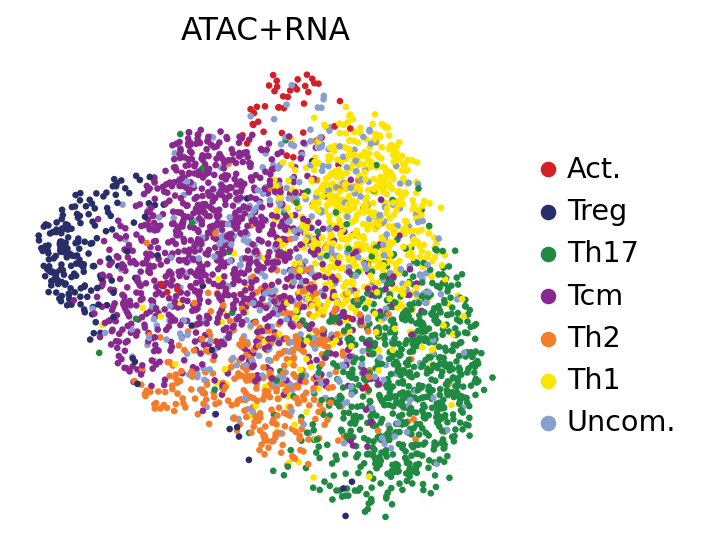

<Figure size 320x320 with 0 Axes>

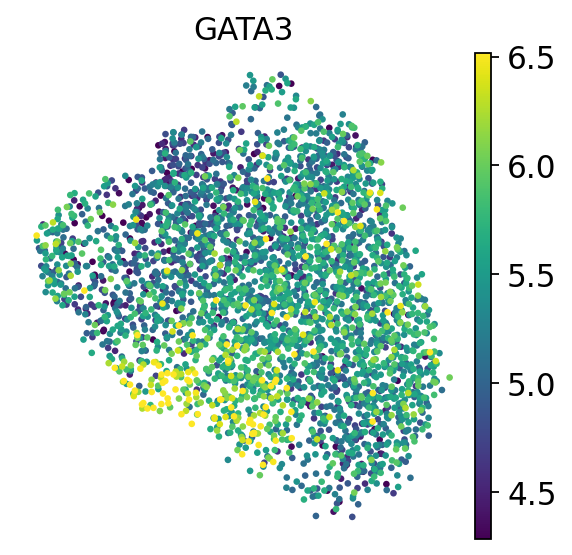

<Figure size 320x320 with 0 Axes>

In [72]:
path2figdir = "figs/NEAT_seq_30LF/"
sc.settings.figdir =path2figdir
figure_name = "_atac+RNA"
format = ".pdf"
save_path = figure_name+format
sc.set_figure_params(vector_friendly=True)

adata_mvi.obsm["latent"] = np.concatenate((latent_expr, latent_acc), axis=1)
sc.pp.neighbors(adata_mvi, use_rep="latent", n_neighbors=25)

sc.tl.umap(adata_mvi,min_dist =0.5)

sc.pl.umap(adata_mvi,color='new_clusters',title = 'ATAC+RNA',
                palette=Cluster_color,frameon = False,
                save=save_path
             )
plt.savefig(save_path, bbox_inches="tight",dpi=300)


figure_name = "_ATAC+RNA_GATA3-norm"
format = ".pdf"
save_path = figure_name+format

sc.pl.umap(adata_mvi,color='GATA3-norm',title = 'GATA3',
       vmin = 'p2', vmax= 'p98',frameon = False,
       save=save_path)
plt.savefig(save_path, bbox_inches="tight", dpi=300)  


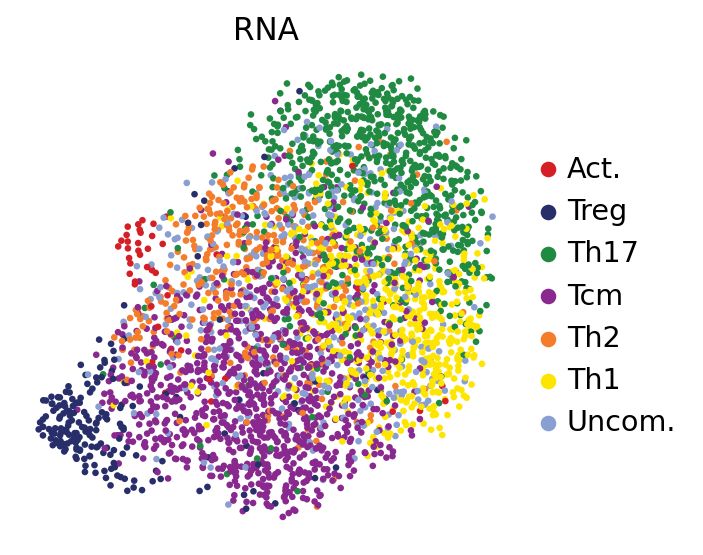

<Figure size 320x320 with 0 Axes>

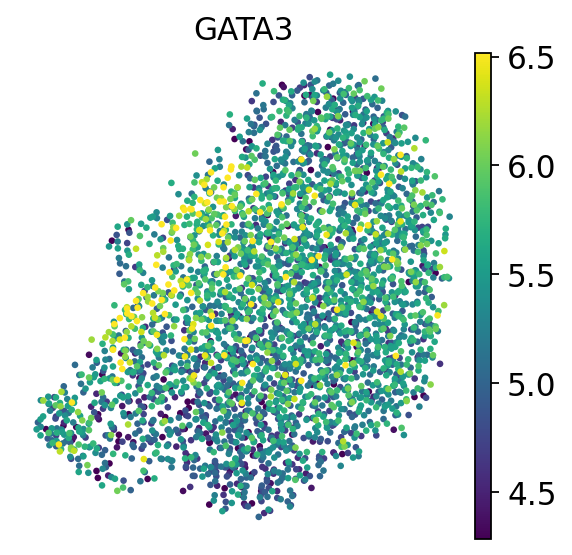

<Figure size 320x320 with 0 Axes>

In [65]:

path2figdir = "figs/NEAT_seq_30LF/"
sc.settings.figdir =path2figdir
figure_name = "_RNA"
format = ".pdf"
save_path = figure_name+format
sc.set_figure_params(vector_friendly=True)

adata_mvi.obsm["latent"] = latent_expr
sc.pp.neighbors(adata_mvi, use_rep="latent", n_neighbors=25)

sc.tl.umap(adata_mvi,min_dist =0.5)

sc.pl.umap(adata_mvi,color='new_clusters',title = 'RNA',
                palette=Cluster_color,frameon = False,
                save=save_path
             )
plt.savefig(save_path, bbox_inches="tight",dpi=300)


figure_name = "_RNA_GATA3-norm"
format = ".pdf"
save_path = figure_name+format

sc.pl.umap(adata_mvi,color='GATA3-norm',title = 'GATA3',
       vmin = 'p2', vmax= 'p98',frameon = False,
       save=save_path)
plt.savefig(save_path, bbox_inches="tight", dpi=300)  

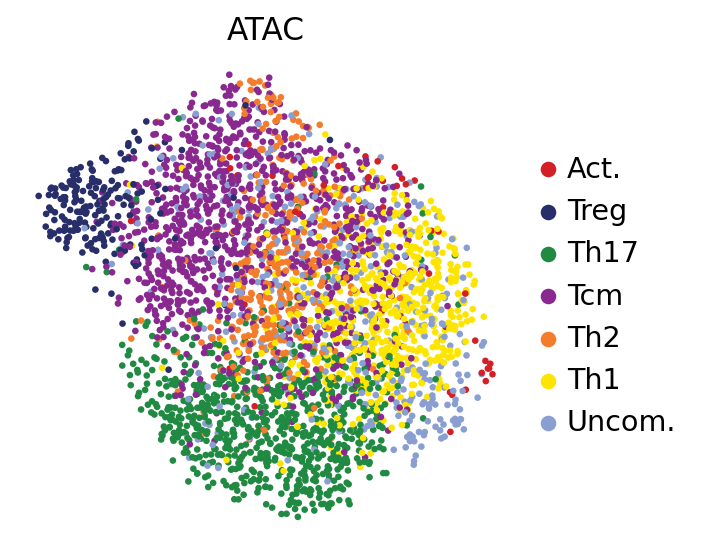

<Figure size 320x320 with 0 Axes>

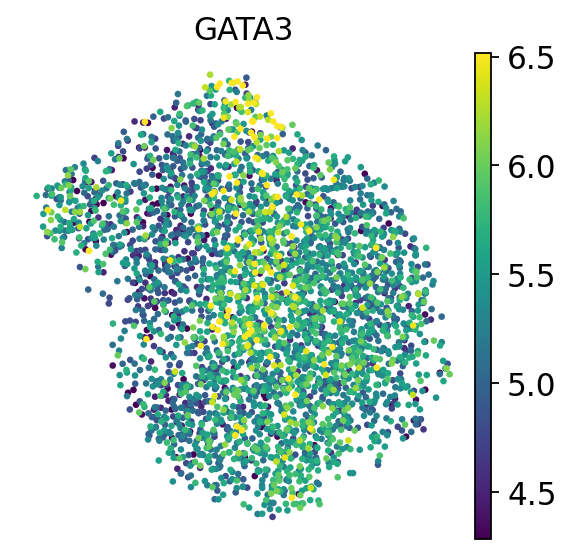

<Figure size 320x320 with 0 Axes>

In [66]:
path2figdir = "figs/NEAT_seq_30LF/"
sc.settings.figdir =path2figdir
figure_name = "_atac"
format = ".pdf"
save_path = figure_name+format
sc.set_figure_params(vector_friendly=True)

adata_mvi.obsm["latent"] = latent_acc
sc.pp.neighbors(adata_mvi, use_rep="latent", n_neighbors=25)

sc.tl.umap(adata_mvi,min_dist =0.5)

sc.pl.umap(adata_mvi,color='new_clusters',title = 'ATAC',
                palette=Cluster_color,frameon = False,
                save=save_path
             )
plt.savefig(save_path, bbox_inches="tight",dpi=300)


figure_name = "_ATAC_GATA3-norm"
format = ".pdf"
save_path = figure_name+format

sc.pl.umap(adata_mvi,color='GATA3-norm',title = 'GATA3',
       vmin = 'p2', vmax= 'p98',frameon = False,
       save=save_path)
plt.savefig(save_path, bbox_inches="tight", dpi=300)  


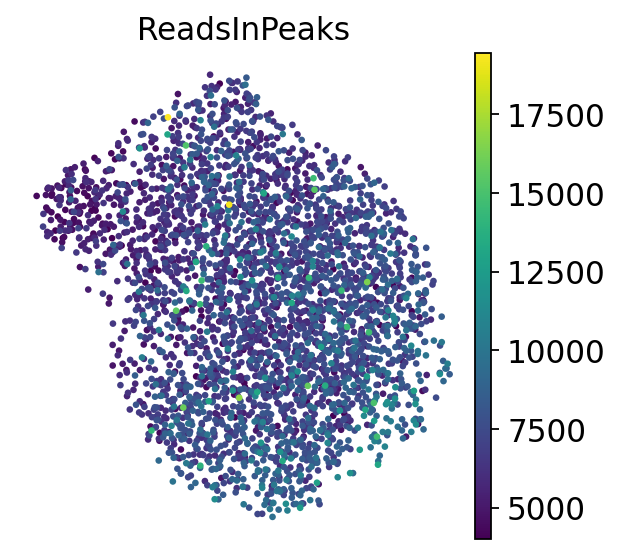

In [67]:
sc.pl.umap(adata_mvi,color=['ReadsInPeaks'],frameon = False)

## visualize LF

In [68]:
### store the latent representations, latent denoms and library size of the autoencoder models
from sklearn import preprocessing
min_max_scaler = preprocessing.MinMaxScaler()

# for i in range(10):
#     adata_mvi.obs["epxr_latent_"+str(i)] = min_max_scaler.fit_transform(latent_expr[:,i].reshape(1,-1))[0,:]

# for i in range(10):
#     adata_mvi.obs["atac_latent_"+str(i)] =  min_max_scaler.fit_transform(latent_acc[:,i].reshape(1,-1))[0,:]

for i in range(30):
    adata_mvi.obs["epxr_latent_"+str(i)] = latent_expr[:,i]

for i in range(30):
    adata_mvi.obs["atac_latent_"+str(i)] =  latent_acc[:,i]    

In [73]:
latentname = ["epxr_latent_"+str(i) for i in range(30)]

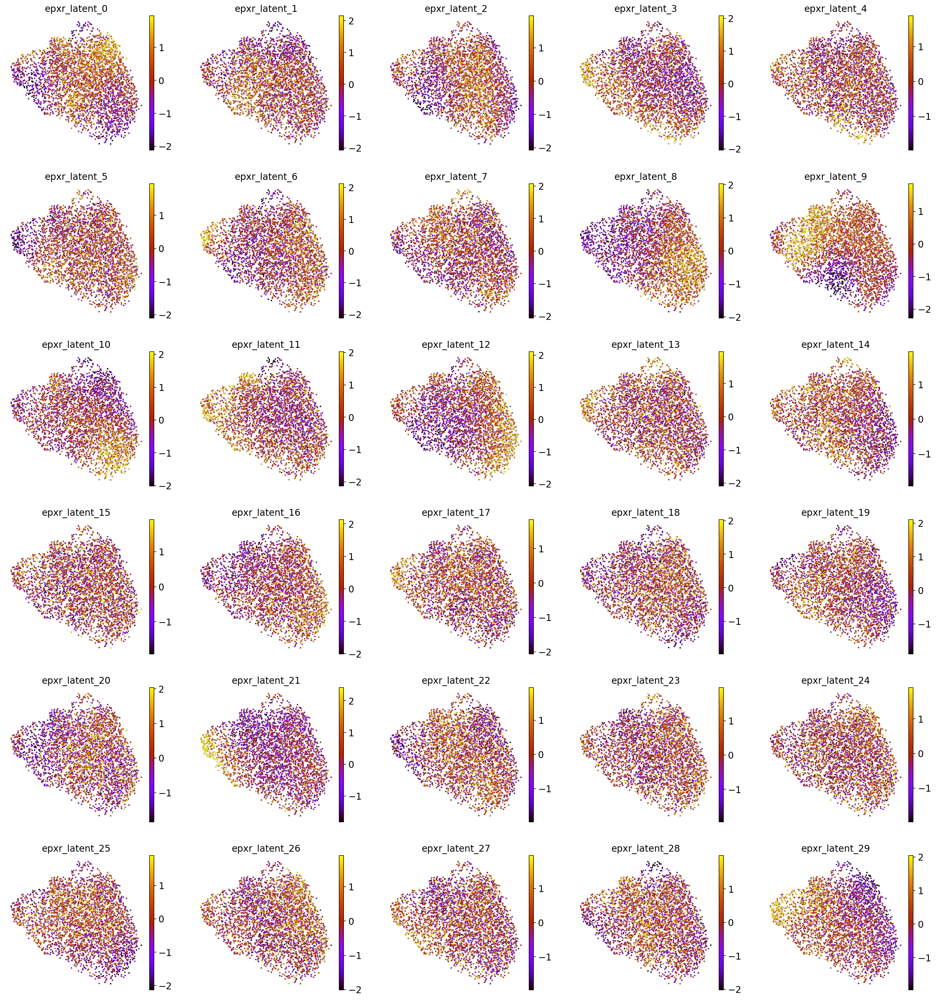

In [74]:
figure_name = "_expr_latent_factor"
save_path = figure_name+format

sc.pl.umap(adata_mvi, frameon=False, size = 15, alpha = 1, add_outline=True,   
       outline_width=(0.1,0), color=latentname,color_map = 'gnuplot',vmin='p2', vmax='p98', save=save_path,
       ncols = 5)   

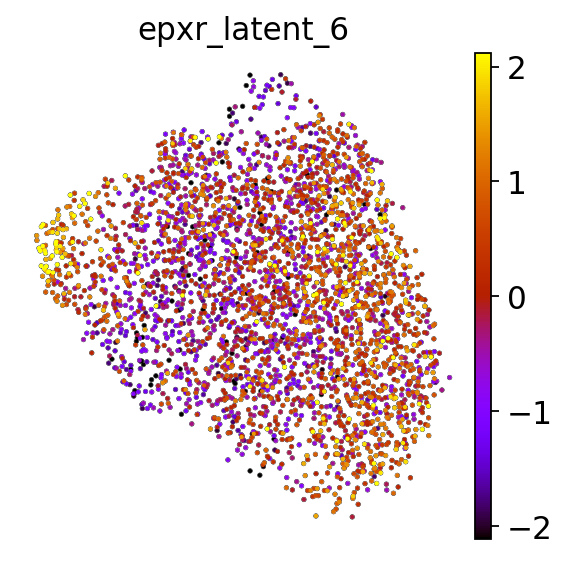

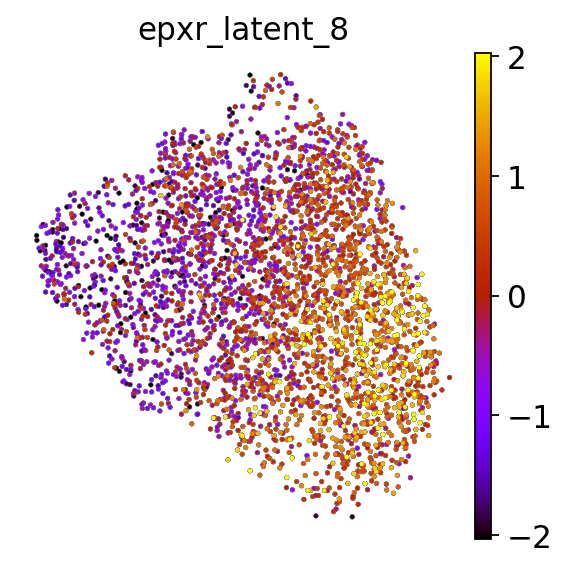

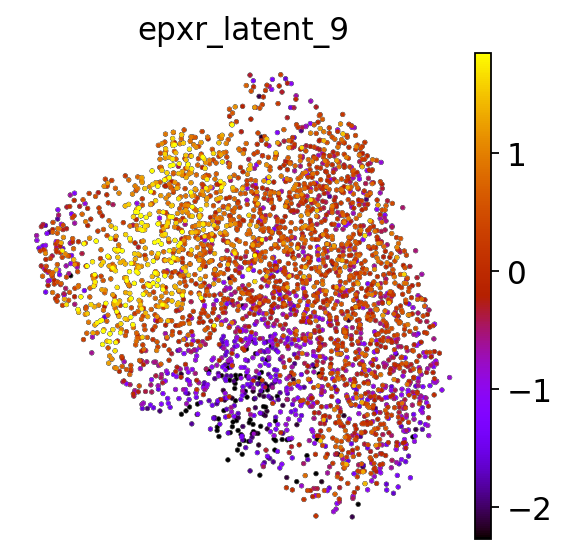

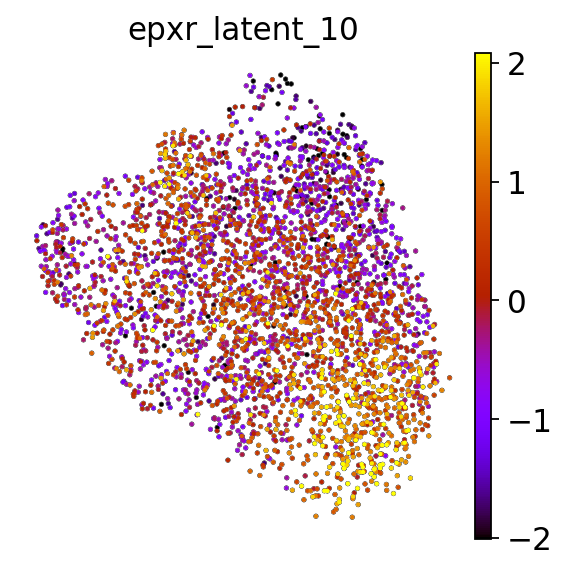

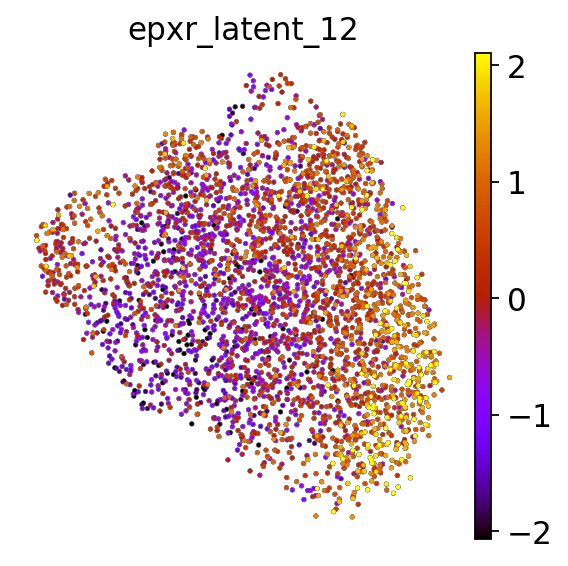

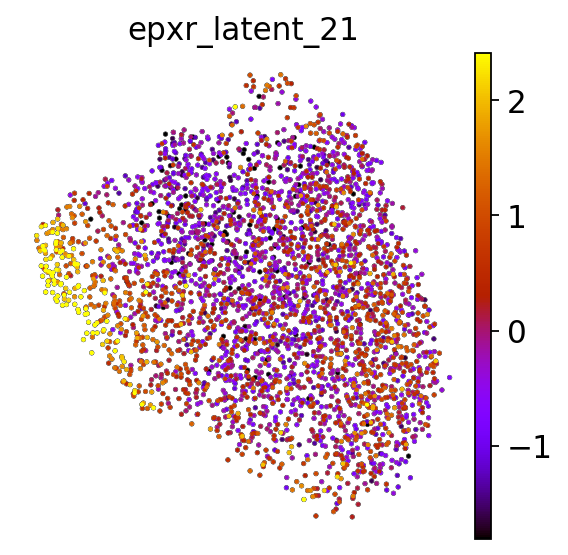

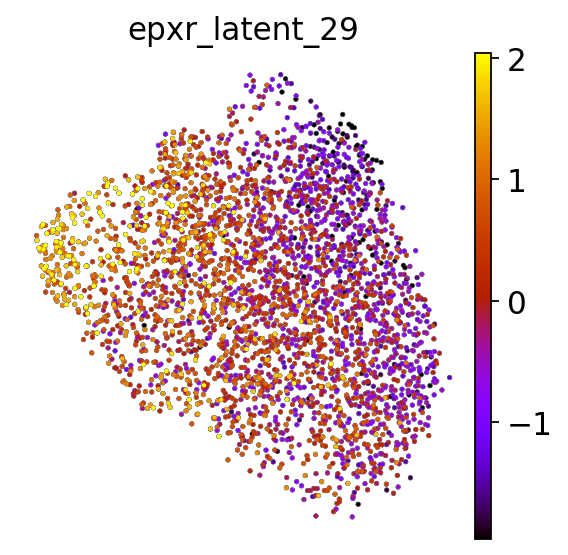

In [76]:
figure_name = "_expr_latent_6"
format = ".pdf"
save_path = figure_name+format

sc.pl.umap(adata_mvi, frameon=False, size = 15, alpha = 1, add_outline=True,   
       outline_width=(0.1,0), color=latentname[6],color_map = 'gnuplot',vmin='p2', vmax='p98', save=save_path)   

figure_name = "_expr_latent_8"
format = ".pdf"
save_path = figure_name+format

sc.pl.umap(adata_mvi, frameon=False, size = 15, alpha = 1, add_outline=True,   
       outline_width=(0.1,0), color=latentname[8],color_map = 'gnuplot',vmin='p2', vmax='p98', save=save_path)   

figure_name = "_expr_latent_9"
format = ".pdf"
save_path = figure_name+format

sc.pl.umap(adata_mvi, frameon=False, size = 15, alpha = 1, add_outline=True,   
       outline_width=(0.1,0), color=latentname[9],color_map = 'gnuplot',vmin='p2', vmax='p98', save=save_path)  

figure_name = "_expr_latent_10"
format = ".pdf"
save_path = figure_name+format

sc.pl.umap(adata_mvi, frameon=False, size = 15, alpha = 1, add_outline=True,   
       outline_width=(0.1,0), color=latentname[10],color_map = 'gnuplot',vmin='p2', vmax='p98', save=save_path) 

figure_name = "_expr_latent_12"
format = ".pdf"
save_path = figure_name+format

sc.pl.umap(adata_mvi, frameon=False, size = 15, alpha = 1, add_outline=True,   
       outline_width=(0.1,0), color=latentname[12],color_map = 'gnuplot',vmin='p2', vmax='p98', save=save_path) 


figure_name = "_expr_latent_21"
format = ".pdf"
save_path = figure_name+format

sc.pl.umap(adata_mvi, frameon=False, size = 15, alpha = 1, add_outline=True,   
       outline_width=(0.1,0), color=latentname[21],color_map = 'gnuplot',vmin='p2', vmax='p98', save=save_path) 


figure_name = "_expr_latent_29"
format = ".pdf"
save_path = figure_name+format

sc.pl.umap(adata_mvi, frameon=False, size = 15, alpha = 1, add_outline=True,   
       outline_width=(0.1,0), color=latentname[29],color_map = 'gnuplot',vmin='p2', vmax='p98', save=save_path) 

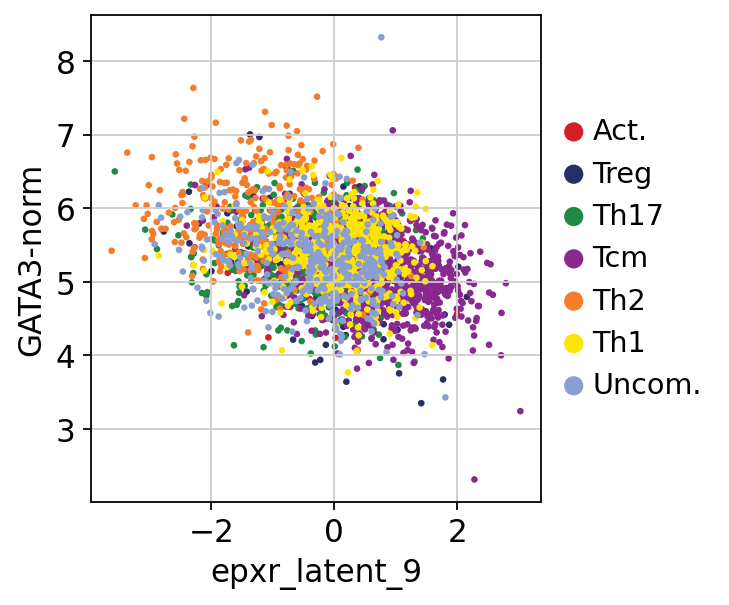

PearsonRResult(statistic=-0.3807266673707756, pvalue=1.0670033896371886e-116)


In [113]:
latentname = ["epxr_latent_"+str(i) for i in range(30)]

figure_name = "_scatter_rna_LF9_GATA3"
save_path = figure_name+format

sc.pl.scatter(adata_mvi,y = 'GATA3-norm', x = latentname[9],color='new_clusters',
title = '',frameon = False,save = save_path)


# correlation between GATA3-norm & EXP LF 3 = -0.34
print(scipy.stats.pearsonr(adata_mvi.obs['GATA3-norm'],adata_mvi.obs[latentname[9]]))

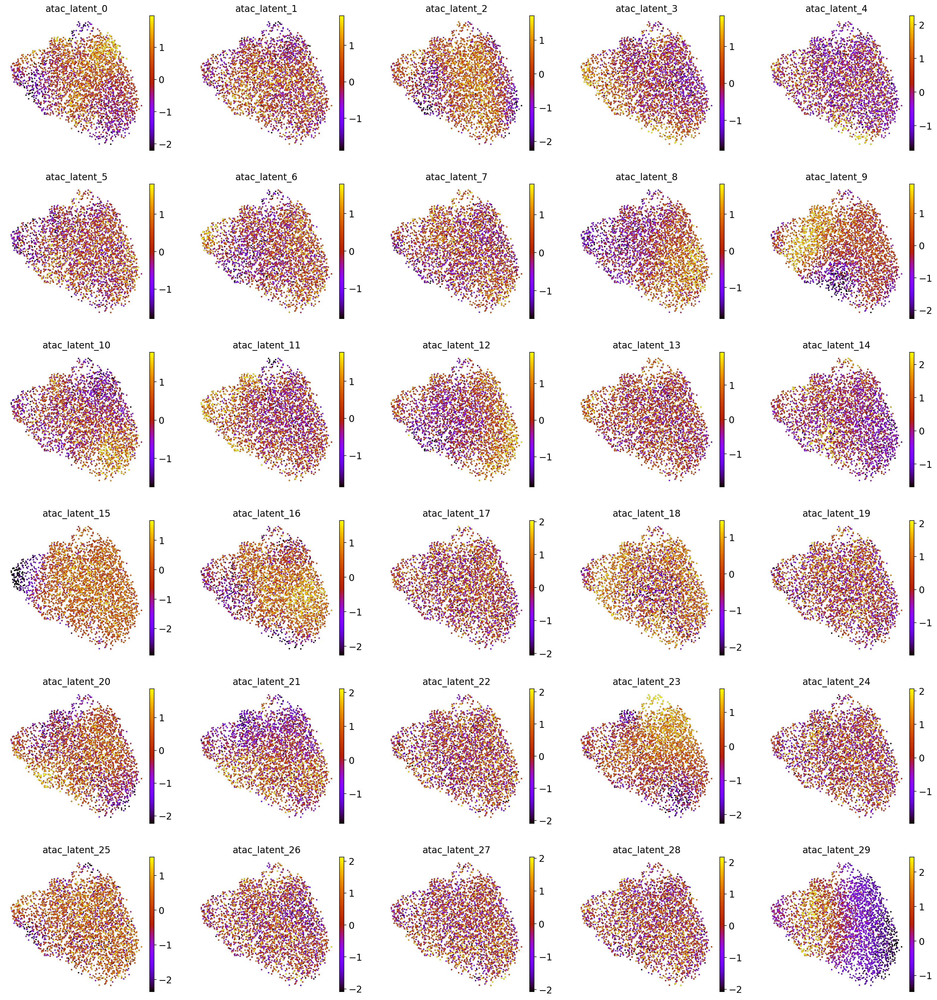

In [78]:
latentname = ["atac_latent_"+str(i) for i in range(30)]

figure_name = "_atac_latent__factor"
save_path = figure_name+format

sc.pl.umap(adata_mvi, frameon=False, size = 15, alpha = 1, add_outline=True,   
       outline_width=(0.1,0), color=latentname,color_map = 'gnuplot',vmin='p2', vmax='p98', save=save_path,
       ncols = 5)   

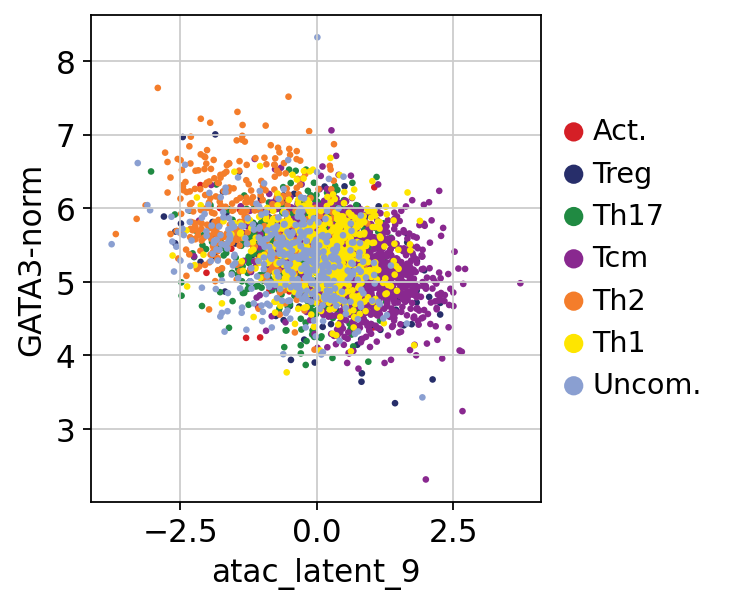

PearsonRResult(statistic=-0.38186365696882685, pvalue=1.926971093287927e-117)


In [112]:
latentname = ["atac_latent_"+str(i) for i in range(30)]

figure_name = "_scatter_atac_LF9_GATA3"
save_path = figure_name+format

sc.pl.scatter(adata_mvi,y = 'GATA3-norm', x = latentname[9],color='new_clusters',
title = '',frameon = False,save=save_path)

print(scipy.stats.pearsonr(adata_mvi.obs['GATA3-norm'],adata_mvi.obs[latentname[9]]))

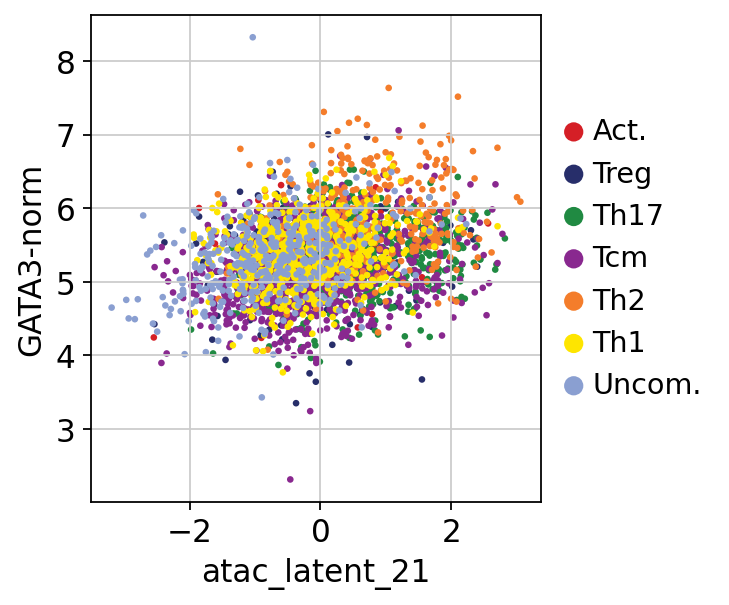

PearsonRResult(statistic=0.25435990732262553, pvalue=6.503010263507078e-51)


In [88]:
sc.pl.scatter(adata_mvi,y = 'GATA3-norm', x = latentname[21],color='new_clusters',
title = '',frameon = False,)

print(scipy.stats.pearsonr(adata_mvi.obs['GATA3-norm'],adata_mvi.obs[latentname[21]]))

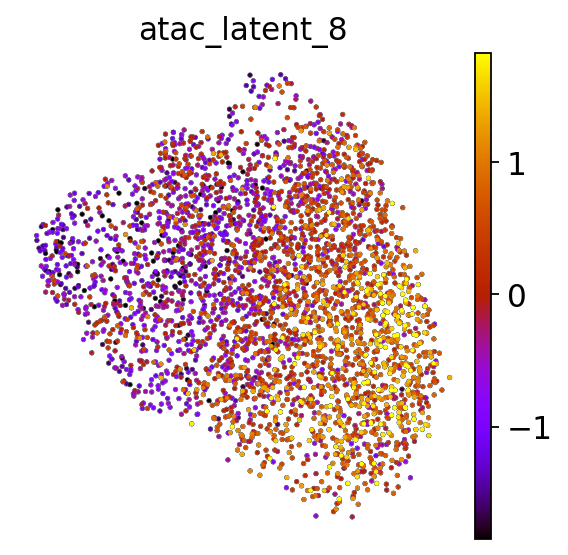

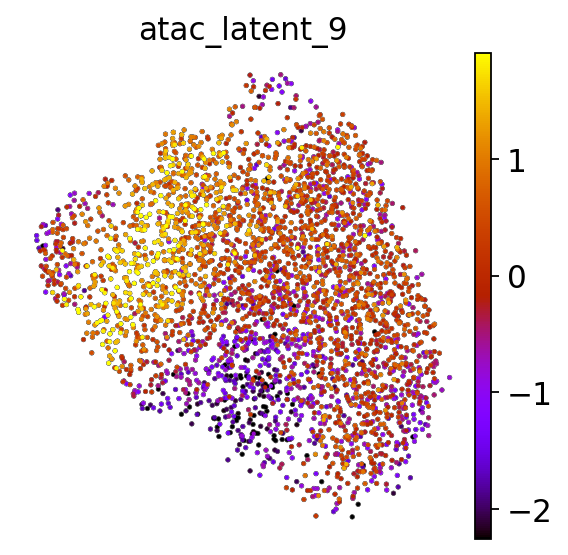

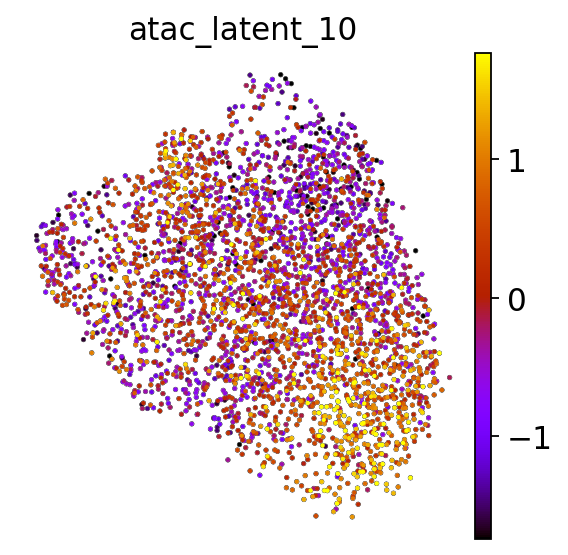

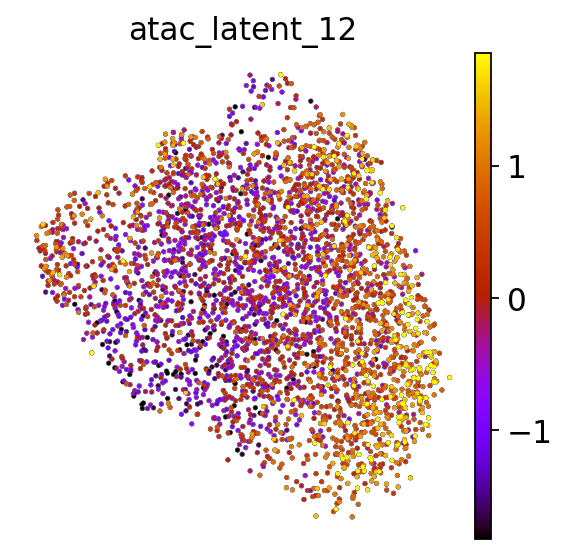

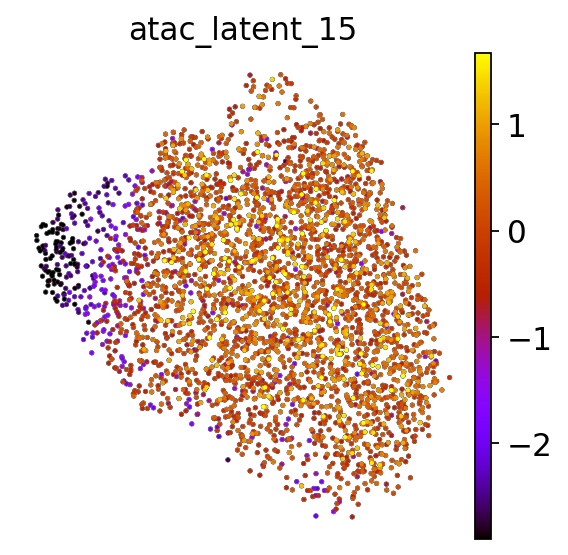

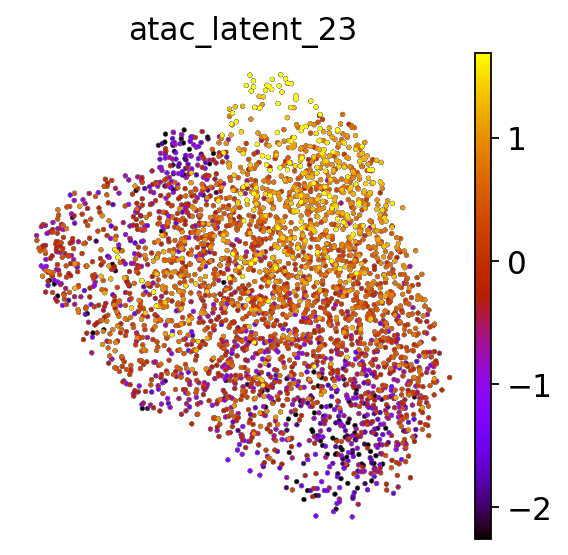

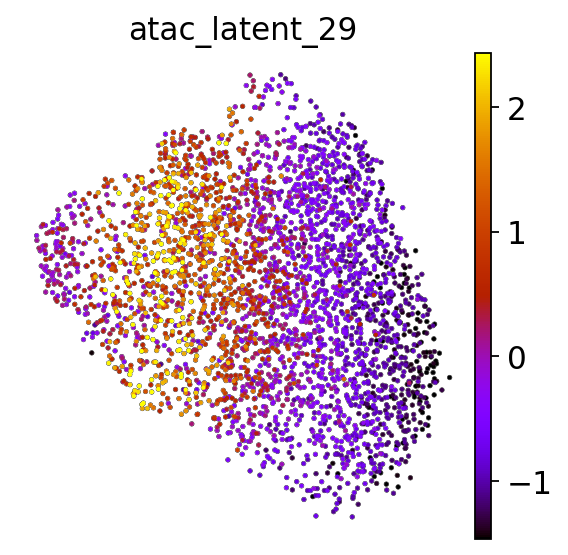

In [89]:
figure_name = "_atac_latent_8"
format = ".pdf"
save_path = figure_name+format

sc.pl.umap(adata_mvi, frameon=False, size = 15, alpha = 1, add_outline=True,   
       outline_width=(0.1,0), color=latentname[8],color_map = 'gnuplot',vmin='p2', vmax='p98', save=save_path)   


figure_name = "_atac_latent_9"
format = ".pdf"
save_path = figure_name+format

sc.pl.umap(adata_mvi, frameon=False, size = 15, alpha = 1, add_outline=True,   
       outline_width=(0.1,0), color=latentname[9],color_map = 'gnuplot',vmin='p2', vmax='p98', save=save_path)   


figure_name = "_atac_latent_10"
format = ".pdf"
save_path = figure_name+format

sc.pl.umap(adata_mvi, frameon=False, size = 15, alpha = 1, add_outline=True,   
       outline_width=(0.1,0), color=latentname[10],color_map = 'gnuplot',vmin='p2', vmax='p98', save=save_path)   


figure_name = "_atac_latent_12"
format = ".pdf"
save_path = figure_name+format

sc.pl.umap(adata_mvi, frameon=False, size = 15, alpha = 1, add_outline=True,   
       outline_width=(0.1,0), color=latentname[12],color_map = 'gnuplot',vmin='p2', vmax='p98', save=save_path)   


figure_name = "_atac_latent_15"
format = ".pdf"
save_path = figure_name+format

sc.pl.umap(adata_mvi, frameon=False, size = 15, alpha = 1, add_outline=True,   
       outline_width=(0.1,0), color=latentname[15],color_map = 'gnuplot',vmin='p2', vmax='p98', save=save_path) 


figure_name = "_atac_latent_23"
format = ".pdf"
save_path = figure_name+format

sc.pl.umap(adata_mvi, frameon=False, size = 15, alpha = 1, add_outline=True,   
       outline_width=(0.1,0), color=latentname[23],color_map = 'gnuplot',vmin='p2', vmax='p98', save=save_path)   


figure_name = "_atac_latent_29"
format = ".pdf"
save_path = figure_name+format

sc.pl.umap(adata_mvi, frameon=False, size = 15, alpha = 1, add_outline=True,   
       outline_width=(0.1,0), color=latentname[29],color_map = 'gnuplot',vmin='p2', vmax='p98', save=save_path)   

In [ ]:
sc.pl.scatter(adata_mvi,y = 'GATA3-norm', x = latentname[3],color='new_clusters',
title = '',frameon = False,)
adata_mvi.obs['GATA3-norm'].corr(adata_mvi.obs[latentname[3]])
print(scipy.stats.pearsonr(adata_mvi.obs['GATA3-norm'],adata_mvi.obs[latentname[3]]))

In [90]:
rnaloading = model.get_rna_loading()
rnaloading = rnaloading.T

[Text(0.5, 20.777777777777786, 'genes')]

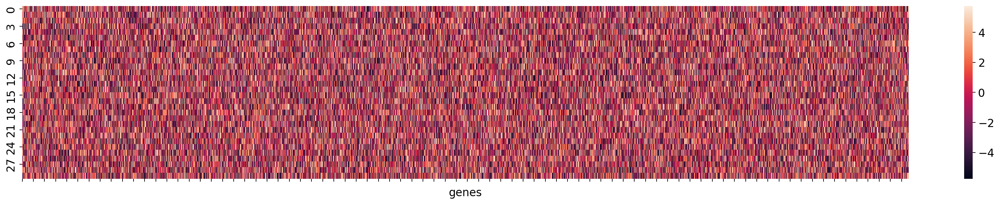

In [91]:
plt.figure(figsize=(25,4))
hm = sns.heatmap(rnaloading)
hm.set(xticklabels=[]) 
hm.set(xlabel="genes")

In [92]:
## get RNA data
from complementary_models import split_rna
rna_data = split_rna(adata_mvi=adata_mvi)

In [94]:
rna_data.write_h5ad("./data/datasets/NEAT_Seq/outputs/rna_interim_30LF.h5ad")

## get the highly variable genes for LF (RNA)

In [95]:
rna_data = sc.read_h5ad("./data/datasets/NEAT_Seq/outputs/rna_interim_30LF.h5ad")

In [96]:
# sc.pp.filter_genes(rna_data, min_cells=15)
rna_data.raw = rna_data
## normlaize the read depths of each cell, then logarithmize the data:
sc.pp.normalize_total(rna_data, target_sum=1e4)
sc.pp.log1p(rna_data)
# Calculate highly variable genes, but with a less stringent dispersion threshold. This set of genes will be our “exogenous” genes:
sc.pp.highly_variable_genes(rna_data, min_disp = 0.2, n_top_genes=None)
rna_data.var['exog'] = rna_data.var.highly_variable.copy()
# Finally, calculate the “endogenous” geneset by intersecting the exogenous set with genes with a higher dispersion threshold:
rna_data.var['endog'] = rna_data.var.exog & (rna_data.var.dispersions_norm > 0.7)
# Restore the raw counts to the counts layer.
rna_data.layers['counts'] = rna_data.raw.to_adata().X.copy()

In [97]:
## add the latent features of model
rna_data.obsm["X_topic_compositions"] = latent_expr

In [98]:
# for i in range(0, 30):
#     print(i),
#     topgenes_latent = model.get_top_genes(100, loadingmatrix=rnaloading, latent_index=i, \
#     rnadata =rna_data,colname="index") # gene names are saved as the adata.var index
#     name = "./data/datasets/NEAT_Seq/RNA_feature/NEAT_seq_latent_{}_genes.txt".format(str(i))
#     np.savetxt(name,np.array(topgenes_latent), fmt='%s')


0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29


In [29]:
for i in range(0, 30):
    print(i),
    topgenes_latent = model.get_top_genes(200, loadingmatrix=rnaloading, latent_index=i, \
    rnadata =rna_data,colname="index") # gene names are saved as the adata.var index
    name = "./figs/NEAT_seq_30LF/RNA_feature/NEAT_seq_latent_{}_genes.txt".format(str(i))
    np.savetxt(name,np.array(topgenes_latent), fmt='%s')


0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29


In [30]:
topgenes_latent_1 = model.get_top_genes(200, loadingmatrix=rnaloading, latent_index=9, rnadata =rna_data,colname="index") # gene names are saved as the adata.var index

In [31]:
## get post gene_list
from tools.enrichment import get_post_genelist, fetch_genelist_enrichments
post_genelist = get_post_genelist(topgenes_latent_1)
results = fetch_genelist_enrichments(post_genelist)

In [32]:
results["results"].keys()

dict_keys(['WikiPathways_2019_Human', 'WikiPathways_2019_Mouse', 'KEGG_2019_Human', 'KEGG_2019_Mouse', 'GO_Molecular_Function_2018', 'GO_Cellular_Component_2018', 'GO_Biological_Process_2018', 'BioPlanet_2019'])

In [33]:
results

{'list_id': 65945119,
 'results': {'WikiPathways_2019_Human': [{'rank': 1,
    'term': 'Heme Biosynthesis WP561',
    'pvalue': 0.0034202318391573132,
    'zscore': 28.561327561327563,
    'combined_score': 162.17255858986445,
    'genes': ['UROS', 'CPOX'],
    'adj_pvalue': 0.5137769980421546},
   {'rank': 2,
    'term': 'NO/cGMP/PKG mediated Neuroprotection WP4008',
    'pvalue': 0.01156531191621091,
    'zscore': 6.83756345177665,
    'combined_score': 30.49378950483647,
    'genes': ['CNGA1', 'CNGB3', 'NFKB1'],
    'adj_pvalue': 0.5137769980421546},
   {'rank': 3,
    'term': 'Apoptosis Modulation and Signaling WP1772',
    'pvalue': 0.013195970913978198,
    'zscore': 4.62420830401126,
    'combined_score': 20.012850913677784,
    'genes': ['AIFM2', 'BIK', 'RIPK1', 'NFKB1'],
    'adj_pvalue': 0.5137769980421546},
   {'rank': 4,
    'term': 'Apoptosis Modulation by HSP70 WP384',
    'pvalue': 0.015214448401771344,
    'zscore': 11.754604872251932,
    'combined_score': 49.199013298

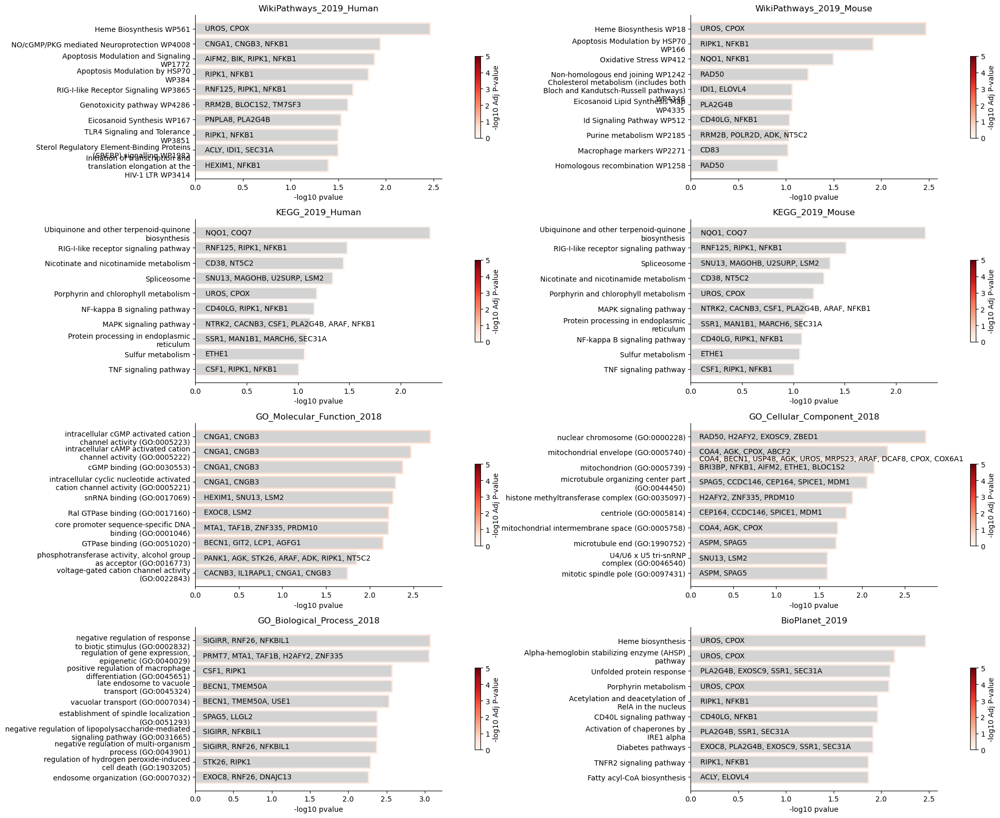

In [34]:
## plot the enrichment results
from tools.enrichment import plot_enrichments_genesets
plot_enrichments_genesets(results)

In [106]:
def raw_umap(
            ncols = 8,
            frameon=False, 
            color_map = 'Blues', 
            add_outline = True, 
            outline_color = ('black','lightgrey'), 
            outline_width = (0, 0.5), 
            size = 30):

    return dict(
        ncols = ncols, frameon = frameon, color_map = color_map,
        add_outline = add_outline, outline_color = outline_color, 
        outline_width = outline_width, size = size
    )

In [107]:
rna_data.obsm["X_topic_compositions"] = latent_expr
rna_data.obsm["X_umap"] = adata_mvi.obsm['X_umap']

In [108]:
sub = rna_data.var.loc[topgenes_latent, :]
latent_genes = sub[sub.highly_variable == True].index.tolist()

[<AxesSubplot:title={'center':'SSR1'}, xlabel='UMAP1', ylabel='UMAP2'>,
 <AxesSubplot:title={'center':'MAN1B1'}, xlabel='UMAP1', ylabel='UMAP2'>,
 <AxesSubplot:title={'center':'MARCH6'}, xlabel='UMAP1', ylabel='UMAP2'>,
 <AxesSubplot:title={'center':'SEC31A'}, xlabel='UMAP1', ylabel='UMAP2'>]

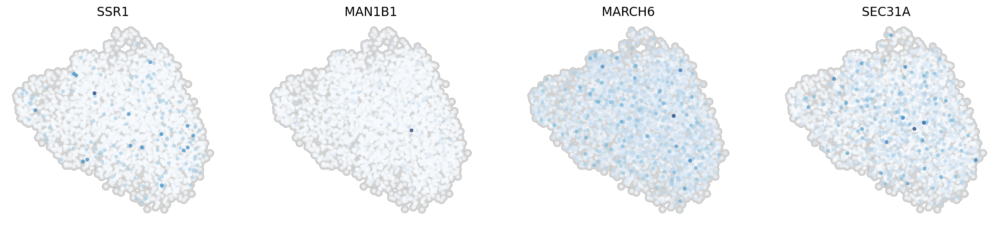

In [114]:
# Protein processing in endoplasmic reticulum
sc.pl.umap(rna_data, color=['SSR1', 'MAN1B1', 'MARCH6', 'SEC31A'], **raw_umap(ncols=5, size=75, color_map="Blues", outline_width=(0, 0.5)),
# vmin='p1', vmax='p99', 
show=False, colorbar_loc=None) 

[<AxesSubplot:title={'center':'NTRK2'}, xlabel='UMAP1', ylabel='UMAP2'>,
 <AxesSubplot:title={'center':'CACNB3'}, xlabel='UMAP1', ylabel='UMAP2'>,
 <AxesSubplot:title={'center':'CSF1'}, xlabel='UMAP1', ylabel='UMAP2'>,
 <AxesSubplot:title={'center':'PLA2G4B'}, xlabel='UMAP1', ylabel='UMAP2'>,
 <AxesSubplot:title={'center':'ARAF'}, xlabel='UMAP1', ylabel='UMAP2'>]

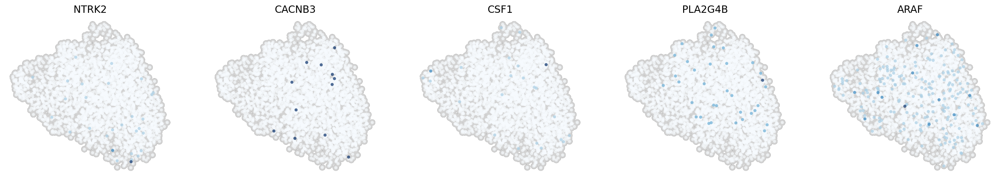

In [115]:
# MAPK signaling pathway
sc.pl.umap(rna_data, color=['NTRK2', 'CACNB3', 'CSF1', 'PLA2G4B', 'ARAF'], **raw_umap(ncols=5, size=75, color_map="Blues", outline_width=(0, 0.5)),
# vmin='p1', vmax='p99', 
show=False, colorbar_loc=None) 

In [117]:
figure_name = "_RNA_latent_3_topgenes"
format = ".pdf"
save_path = figure_name+format

sc.pl.umap(rna_data, color=topgenes_latent_1, **raw_umap(ncols=5, size=75, color_map="Blues", outline_width=(0, 0.5)),
vmin='p2', vmax='p98', save=save_path,
show=False, colorbar_loc=None) 

[<AxesSubplot:title={'center':'SKAP2'}, xlabel='UMAP1', ylabel='UMAP2'>,
 <AxesSubplot:title={'center':'ABCF2'}, xlabel='UMAP1', ylabel='UMAP2'>,
 <AxesSubplot:title={'center':'TERC'}, xlabel='UMAP1', ylabel='UMAP2'>,
 <AxesSubplot:title={'center':'TRAPPC3'}, xlabel='UMAP1', ylabel='UMAP2'>,
 <AxesSubplot:title={'center':'TAF1B'}, xlabel='UMAP1', ylabel='UMAP2'>,
 <AxesSubplot:title={'center':'NEUROD2'}, xlabel='UMAP1', ylabel='UMAP2'>,
 <AxesSubplot:title={'center':'GARS'}, xlabel='UMAP1', ylabel='UMAP2'>,
 <AxesSubplot:title={'center':'SFMBT2'}, xlabel='UMAP1', ylabel='UMAP2'>,
 <AxesSubplot:title={'center':'EAF1'}, xlabel='UMAP1', ylabel='UMAP2'>,
 <AxesSubplot:title={'center':'PPP1R16B'}, xlabel='UMAP1', ylabel='UMAP2'>,
 <AxesSubplot:title={'center':'CLYBL'}, xlabel='UMAP1', ylabel='UMAP2'>,
 <AxesSubplot:title={'center':'MAGI2'}, xlabel='UMAP1', ylabel='UMAP2'>,
 <AxesSubplot:title={'center':'HEXIM1'}, xlabel='UMAP1', ylabel='UMAP2'>,
 <AxesSubplot:title={'center':'TMEM175'}, xla

In [ ]:
# MAPK signaling pathway
sc.pl.umap(rna_data, color=['NTRK2', 'CACNB3', 'CSF1', 'PLA2G4B', 'ARAF'], **raw_umap(ncols=5, size=75, color_map="Blues", outline_width=(0, 0.5)),
# vmin='p1', vmax='p99', 
show=False, colorbar_loc=None) 

In [123]:
LF9_genes_selected = ['LRMP','RRM2B','BAZ2B']
figure_name = "_RNA_latent_9_topgenes_selected"
format = ".pdf"
save_path = figure_name+format
sc.pl.umap(rna_data, color=LF9_genes_selected, **raw_umap(ncols=3, size=75, color_map="Blues", outline_width=(0, 0.5)),
vmin='p1', vmax='p99', save=save_path,show=False, colorbar_loc=None) 


[<AxesSubplot:title={'center':'LRMP'}, xlabel='UMAP1', ylabel='UMAP2'>,
 <AxesSubplot:title={'center':'RRM2B'}, xlabel='UMAP1', ylabel='UMAP2'>,
 <AxesSubplot:title={'center':'BAZ2B'}, xlabel='UMAP1', ylabel='UMAP2'>]

In [118]:
rna_data

AnnData object with n_obs × n_vars = 3370 × 13380
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'cell_id', 'Sample', 'TSSEnrichment', 'ReadsInTSS', 'ReadsInPromoter', 'ReadsInBlacklist', 'PromoterRatio', 'PassQC', 'NucleosomeRatio', 'nMultiFrags', 'nMonoFrags', 'nFrags', 'nDiFrags', 'BlacklistRatio', 'Clusters', 'ReadsInPeaks', 'FRIP', 'cell_id2', 'nCount_ATAC', 'nFeature_ATAC', 'nCount_ChromVar', 'nFeature_ChromVar', 'RNA_snn_res.0.6', 'seurat_clusters', 'nCount_ADT', 'nFeature_ADT', 'S.Score', 'G2M.Score', 'Phase', 'FOXP3-norm', 'Helios-norm', 'Tbet-norm', 'GATA3-norm', 'RORgT-norm', 'batch_id', 'modality', 'new_clusters', '_scvi_batch', '_scvi_labels', 'epxr_latent_0', 'epxr_latent_1', 'epxr_latent_2', 'epxr_latent_3', 'epxr_latent_4', 'epxr_latent_5', 'epxr_latent_6', 'epxr_latent_7', 'epxr_latent_8', 'epxr_latent_9', 'epxr_latent_10', 'epxr_latent_11', 'epxr_latent_12', 'epxr_latent_13', 'epxr_latent_14', 'epxr_latent_15', 'epxr_latent_16', 'epxr_latent_17', 'epxr_latent_18

In [134]:
rna_data.write_h5ad("./data/datasets/NEAT_Seq/outputs/rna_interim_30LF_v1.h5ad")

## ATAC LF

In [8]:
## split the atac data
from complementary_models import split_atac, reindex_atac

atac_data = split_atac(adata_mvi=adata_mvi)
# atac_data = reindex_atac(atac_data)

In [9]:
atac_data.var.index.names = ["Id"]
atac_data.var.index = atac_data.var.index.astype(str)
atac_data.var

,gene_ids,feature_types,n_cells,modality
Id,,,,
chr1-817095-817595,chr1-817095-817595,Peaks,45,Peaks
chr1-827298-827798,chr1-827298-827798,Peaks,153,Peaks
chr1-844407-844907,chr1-844407-844907,Peaks,45,Peaks
chr1-857908-858408,chr1-857908-858408,Peaks,16,Peaks
chr1-869618-870118,chr1-869618-870118,Peaks,133,Peaks
...,...,...,...,...
chrX-155279869-155280369,chrX-155279869-155280369,Peaks,18,Peaks
chrX-155612706-155613206,chrX-155612706-155613206,Peaks,48,Peaks
chrX-155632526-155633026,chrX-155632526-155633026,Peaks,70,Peaks


In [10]:
split = atac_data.var_names.str.split(r"[-]")
split

atac_data.var["chr"] = split.map(lambda x: x[0])
atac_data.var["begin"] = split.map(lambda x: x[1]).astype(int)
atac_data.var["end"] = split.map(lambda x: x[2]).astype(int)
atac_data.var.head()


,gene_ids,feature_types,n_cells,modality,chr,begin,end
Id,,,,,,,
chr1-817095-817595,chr1-817095-817595,Peaks,45,Peaks,chr1,817095,817595
chr1-827298-827798,chr1-827298-827798,Peaks,153,Peaks,chr1,827298,827798
chr1-844407-844907,chr1-844407-844907,Peaks,45,Peaks,chr1,844407,844907
chr1-857908-858408,chr1-857908-858408,Peaks,16,Peaks,chr1,857908,858408
chr1-869618-870118,chr1-869618-870118,Peaks,133,Peaks,chr1,869618,870118


In [11]:
atac_data.var = atac_data.var.rename(columns={"begin":"start"})


In [12]:
# atac_data.write_h5ad("./data/datasets/NEAT_Seq/outputs/atac_interim.h5ad")
atac_data.write_h5ad("./data/datasets/NEAT_Seq/outputs/atac_interim_1.h5ad")



## change the virtual environment HALO2 (TSS information)

In [1]:
import mira
import anndata
import scanpy as sc
import matplotlib.pyplot as plt
import seaborn as sns
import warnings
import tools
warnings.simplefilter("ignore")

mira.datasets.PseudotimeTrajectoryInferenceTutorial()
atac_data = sc.read_h5ad("./data/datasets/NEAT_Seq/outputs/atac_interim_1.h5ad")
mira.utils.pretty_sderr()


INFO:mira.datasets.datasets:Dataset already on disk.
INFO:mira.datasets.datasets:Dataset contents:
	* mira-datasets/shareseq.hair_follicle.joint_representation.h5ad


In [2]:
atac_data

AnnData object with n_obs × n_vars = 3370 × 78203
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'cell_id', 'Sample', 'TSSEnrichment', 'ReadsInTSS', 'ReadsInPromoter', 'ReadsInBlacklist', 'PromoterRatio', 'PassQC', 'NucleosomeRatio', 'nMultiFrags', 'nMonoFrags', 'nFrags', 'nDiFrags', 'BlacklistRatio', 'Clusters', 'ReadsInPeaks', 'FRIP', 'cell_id2', 'nCount_ATAC', 'nFeature_ATAC', 'nCount_ChromVar', 'nFeature_ChromVar', 'RNA_snn_res.0.6', 'seurat_clusters', 'nCount_ADT', 'nFeature_ADT', 'S.Score', 'G2M.Score', 'Phase', 'FOXP3-norm', 'Helios-norm', 'Tbet-norm', 'GATA3-norm', 'RORgT-norm', 'batch_id', 'modality', 'new_clusters'
    var: 'gene_ids', 'feature_types', 'n_cells', 'modality', 'chr', 'start', 'end'

In [2]:
# dowdload reference genome to annotate transcription factor binding sites

# !wget https://hgdownload.soe.ucsc.edu/goldenPath/hg38/bigZips/hg38.fa.gz 
# !gzip -d -f hg38.fa.gz

In [3]:
import tools
import logging
tools.motif_scan.logger.setLevel(logging.INFO)
tools.get_motif_hits_in_peaks(atac_data,
                    genome_fasta='hg38.fa',species="all",
                    chrom = 'chr', start = 'start', end = 'end')

INFO:tools.motif_scan:Getting peak sequences ...
78203it [00:01, 76404.83it/s]
INFO:tools.motif_scan:Scanning peaks for motif hits with p >= 0.0001 ...
INFO:tools.motif_scan:Building motif background models ...
INFO:tools.motif_scan:Starting scan ...
INFO:tools.motif_scan:Found 1000000 motif hits ...
INFO:tools.motif_scan:Found 2000000 motif hits ...
INFO:tools.motif_scan:Found 3000000 motif hits ...
INFO:tools.motif_scan:Found 4000000 motif hits ...
INFO:tools.motif_scan:Found 5000000 motif hits ...
INFO:tools.motif_scan:Found 6000000 motif hits ...
INFO:tools.motif_scan:Found 7000000 motif hits ...
INFO:tools.motif_scan:Found 8000000 motif hits ...
INFO:tools.motif_scan:Found 9000000 motif hits ...
INFO:tools.motif_scan:Formatting hits matrix ...
INFO:tools.regulators:Added key to varm: motifs_hits
INFO:tools.regulators:Added key to uns: motifs


In [4]:
atac_data.uns

OverloadedDict, wrapping:
	OrderedDict([('motifs', {'id': ['MA0483.1', 'MA0885.1', 'MA0677.1', 'MA0117.2', 'MA0858.1', 'MA0883.1', 'MA0611.1', 'MA0494.1', 'MA0622.1', 'MA1629.1', 'MA0880.1', 'MA1603.1', 'MA1630.1', 'MA0857.1', 'MA0521.1', 'MA0591.1', 'MA0519.1', 'MA1624.1', 'MA0125.1', 'MA0704.1', 'MA1625.1', 'MA0853.1', 'MA0860.1', 'MA0816.1', 'MA0911.1', 'MA1684.1', 'MA1604.1', 'MA0122.3', 'MA1606.1', 'MA0480.1', 'MA0720.1', 'MA0705.1', 'MA0065.2', 'MA0029.1', 'MA1627.1', 'MA1628.1', 'MA1621.1', 'MA0146.2', 'MA0135.1', 'MA0602.1', 'MA0078.1', 'MA0728.1', 'MA0514.1', 'MA0626.1', 'MA0739.1', 'MA0505.1', 'MA0520.1', 'MA0614.1', 'MA0643.1', 'MA0067.1', 'MA0869.1', 'MA0676.1', 'MA0608.1', 'MA0515.1', 'MA0859.1', 'MA0615.1', 'MA0603.1', 'MA0150.2', 'MA0601.1', 'MA0518.1', 'MA0897.1', 'MA0467.1', 'MA0004.1', 'MA0503.1', 'MA0164.1', 'MA0896.1', 'MA0879.1', 'MA0006.1', 'MA0142.1', 'MA0512.2', 'MA1153.1', 'MA0493.1', 'MA1607.1', 'MA0633.1', 'MA0742.1', 'MA0854.1', 'MA1619.1', 'MA0152.1', 'MA16

In [6]:
atac_data.write_h5ad("./data/datasets/NEAT_Seq/outputs/atac_interim_motif.h5ad")

## Back to HALO environment (Motif Enrichment)

In [1]:
from typing import Dict, Iterable, Optional

import numpy as np
import torch
import scanpy as sc

from torch.distributions import Normal, Poisson
from torch.distributions import kl_divergence as kld
from torch import tensor
from complementary_models import HALOMASKVIR as HALOVI
from complementary_models import HALOMASKVAE as HALOVAE
import scvi
import pandas as pd

import matplotlib.pyplot as plt
import seaborn as sns
import scipy


Global seed set to 0


In [2]:
adata_mvi = sc.read_h5ad("./data/datasets/NEAT_Seq/outputs/multiome_interim.h5ad")

HALOVI.setup_anndata(adata_mvi, batch_key="modality", time_key='GATA3-norm')
model = HALOVI(
    adata_mvi,
    n_genes=(adata_mvi.var['feature_types']=='Gene Expression').sum(),
    n_regions=(adata_mvi.var['feature_types']=='Peaks').sum(),
    n_layers = 2,
    n_latent = 30,
    n_dependent=15
)


n_genes :13380
n_peaks:78203
fine tune is False
gate decoder initialization n_input 30, n_output 78203,         n_hidden_local 20, n_hidden_global 128, n_cat_list [1], *cat_list 1


In [3]:
model = model.load("model_NEAT_seq_30LF_filtered_causal_alpha_0.05_epoch_1000",adata_mvi)

INFO     File model_NEAT_seq_30LF_filtered_causal_alpha_0.05_epoch_1000/model.pt already     
         downloaded                                                                          
n_genes :13380
n_peaks:78203
fine tune is False
gate decoder initialization n_input 30, n_output 78203,         n_hidden_local 20, n_hidden_global 128, n_cat_list [1], *cat_list 1


In [4]:
loadings = model.get_atac_loading()
print(loadings.shape)
loadings = loadings.T

(78203, 30)


In [5]:
atac_data = sc.read_h5ad("./data/datasets/NEAT_Seq/outputs/atac_interim_motif.h5ad")

In [6]:
import matplotlib.pyplot as plt

def compare_latent_TFs(l1=0, l2=5):
    latent_l1_tf, index_learnt = model.get_enriched_TFs(atac_data, topic_num=l1, top_quantile=5e-5, loadings=loadings, num_exo_features=1e6)
    latent_l2_tf, index_learnt = model.get_enriched_TFs(atac_data, topic_num=l2, top_quantile=5e-5, loadings=loadings, num_exo_features=1e6)
    model.plot_compare_topic_enrichments(l1, l2, pval_threshold=(1e-20, 1e-15), color="pink")



Finding enrichments:   0%|          | 0/107 [00:00<?, ?it/s]

Finding enrichments:   0%|          | 0/107 [00:00<?, ?it/s]

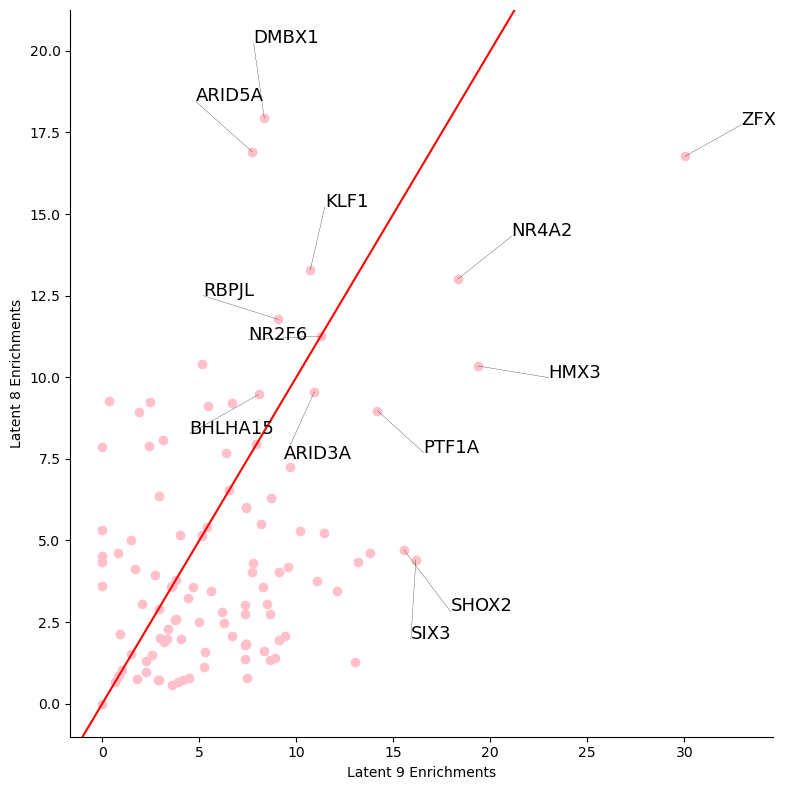

In [7]:
compare_latent_TFs(9,8)

In [ ]:
m1 = model.get_enrichments(9, factor_type = 'motifs')
m2 = model.get_enrichments(8, factor_type = 'motifs')  

<AxesSubplot:xlabel='Latent 9 Enrichments', ylabel='Latent 8 Enrichments'>

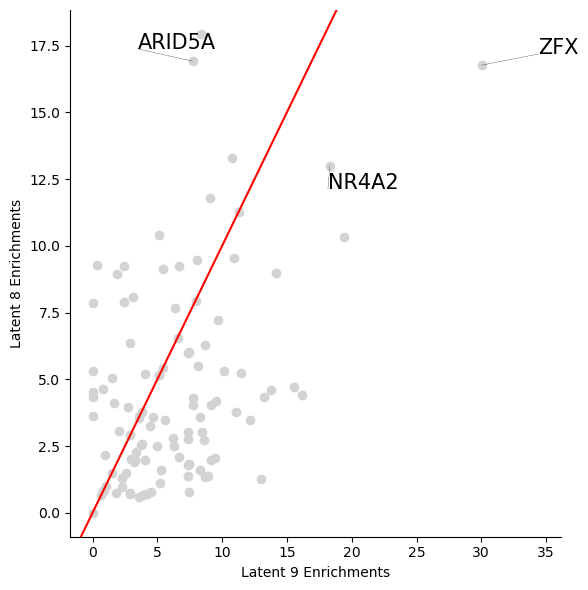

In [8]:
model.plot_compare_topic_enrichments(9, 8, pval_threshold=(1e-50, 1e-50), label_factors = ['ARID5A','NR4A2','ZFX'],
figsize = (6,6),fontsize = 15,label_closeness =3, max_label_repeats = 3,color = 'lightgrey')

In [21]:
pwd

'/home/haiyi/Desktop/HierachicalCausal_Omics'

Finding enrichments:   0%|          | 0/107 [00:00<?, ?it/s]

Finding enrichments:   0%|          | 0/107 [00:00<?, ?it/s]

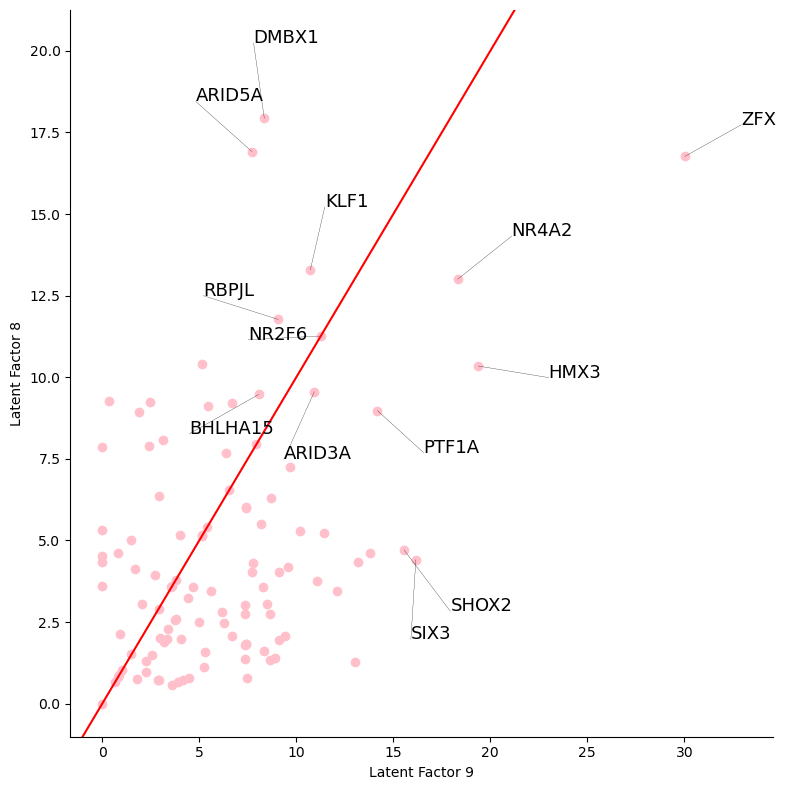

In [13]:
compare_latent_TFs(9,8)